# <div style="padding:20px;color:white;margin:0;font-size:100%;text-align:left;display:fill;border-radius:5px;background-color:#663100;overflow:hidden"> **PSX-Tick Forecast Challenge**

### Predicting Pakistan Stock Exchange Movement at Tick Level

### <div style="padding:20px;color:white;margin:0;font-size:100%;text-align:left;display:fill;border-radius:5px;background-color:#663100;overflow:hidden"> 📖 Background

The data has been collected from Pakistan Stock Exchange almost regularly from January to October 2023. There is one ID column, 6 input columns, and one output column labeled as "Price" in this dataset.


### <div style="padding:20px;color:white;margin:0;font-size:100%;text-align:left;display:fill;border-radius:5px;background-color:#663100;overflow:hidden"> 💾 The Data

The data for this competition is stored in table, `train.csv` and `test.csv`.

### `company.csv` and `test.csv`

##### **Input Variables**

This table contains aggregated data for each PSx Stock:

- **ID** - The identity of each record in a sequence. This must not be modified because the identity column helps in the evaluation of the results submitted by participants.
- **Scrip** - The name or code of a company registered in PSX
- **Datetime** - The date and time at which the transaction was performed i.e., the shares were purchased/sold
- **Date** - The date at which the transaction was performed i.e., the shares were purchased/sold
- **Volume** - It refers to the total number of shares or contracts traded
- **OpenDaily** - It refers to the price at which a share or security first trades upon the opening of the market for a particular trading session
- **LDCP** - It stands for "Last Day Closing Price." This term refers to the closing price of a share or security on the most recent trading day

##### **Output Variables**

- **Price** - It refers to the current market value of a stock or security, which is determined by the most recent transaction between a buyer and a seller.


### <div style="padding:20px;color:white;margin:0;font-size:100%;text-align:left;display:fill;border-radius:5px;background-color:#663100;overflow:hidden"> Import Libraries


In [204]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
from scipy import stats
from prophet import Prophet
from sklearn.preprocessing import StandardScaler
from statsmodels.tsa.seasonal import STL

### <div style="padding:20px;color:white;margin:0;font-size:100%;text-align:left;display:fill;border-radius:5px;background-color:#663100;overflow:hidden"> Loading the Datasets


In [205]:
train = pd.read_csv('train.csv')
test = pd.read_csv('test.csv')

### <div style="padding:20px;color:white;margin:0;font-size:100%;text-align:left;display:fill;border-radius:5px;background-color:#663100;overflow:hidden"> Getting Insights about the Data


In [206]:
train.head()

,ID,Scrip,Datetime,Price,Volume,Date,Open_daily,LDCP
0,2429,ABOT,2023-01-02 18:00:00,460.53,7500,2023-01-02,456.14,463.31
1,2430,ABOT,2023-01-03 18:00:00,450.20,10400,2023-01-03,455.00,460.53
2,2431,ABOT,2023-01-04 18:00:00,450.00,3350,2023-01-04,450.00,450.20
3,2432,ABOT,2023-01-05 18:00:00,444.69,11200,2023-01-05,445.00,450.00
4,2433,ABOT,2023-01-06 18:00:00,438.00,8900,2023-01-06,444.00,444.69


In [207]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 57058 entries, 0 to 57057
Data columns (total 8 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   ID          57058 non-null  int64  
 1   Scrip       57058 non-null  object 
 2   Datetime    57058 non-null  object 
 3   Price       57058 non-null  float64
 4   Volume      57058 non-null  int64  
 5   Date        57058 non-null  object 
 6   Open_daily  57058 non-null  float64
 7   LDCP        57058 non-null  float64
dtypes: float64(3), int64(2), object(3)
memory usage: 3.5+ MB


- The dataset contain 57058 rows from index range 0 to 57057.
- The columns don't contain any type of null values
- There are total 8 columns (7 independant and 1 dependant column)
- The Data and Datetime columns don't have correct Dtypes
- 3 columns are float, 2 int, 1 object or string and 2 with wrong data types


In [208]:
train.describe()

,ID,Price,Volume,Open_daily,LDCP
count,57058.000000,57058.000000,5.705800e+04,57058.000000,57058.000000
mean,40266.999387,45.930993,6.175232e+03,45.716802,45.639029
std,22107.290972,76.174140,4.833934e+04,75.855968,76.000625
min,2429.000000,4.010000,-1.150000e+04,0.000000,4.140000
25%,21510.250000,7.850000,5.000000e+02,8.140000,7.920000
50%,40846.500000,11.600000,1.000000e+03,11.680000,11.650000
75%,60606.750000,58.617500,4.000000e+03,58.270000,58.550000
max,79699.000000,460.530000,8.302513e+06,456.140000,463.310000


### <div style="padding:20px;color:white;margin:0;font-size:100%;text-align:left;display:fill;border-radius:5px;background-color:#663100;overflow:hidden"> Correcting Data Types of Data and Datetime columns


In [209]:
train['Date'] = pd.to_datetime(train['Date'])
train['Datetime'] = pd.to_datetime(train['Datetime'])

In [210]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 57058 entries, 0 to 57057
Data columns (total 8 columns):
 #   Column      Non-Null Count  Dtype         
---  ------      --------------  -----         
 0   ID          57058 non-null  int64         
 1   Scrip       57058 non-null  object        
 2   Datetime    57058 non-null  datetime64[ns]
 3   Price       57058 non-null  float64       
 4   Volume      57058 non-null  int64         
 5   Date        57058 non-null  datetime64[ns]
 6   Open_daily  57058 non-null  float64       
 7   LDCP        57058 non-null  float64       
dtypes: datetime64[ns](2), float64(3), int64(2), object(1)
memory usage: 3.5+ MB


Now all the columns have the correct data types


#### Extracting usefull informtation form Date columns


In [211]:
train['Year'] = train['Date'].dt.year
train['Month'] = train['Date'].dt.month
train['Day'] = train['Date'].dt.day
train['Quarter'] = train['Datetime'].dt.quarter.astype(str)


In [212]:
train['DayOfWeek'] = train['Datetime'].dt.dayofweek
train['Hour'] = train['Datetime'].dt.hour

In [213]:
train['Year from Datetime'] = train['Datetime'].dt.year
train['Month from Datetime'] = train['Datetime'].dt.month
train['Day from Datetime'] = train['Datetime'].dt.day

In [214]:
#checking that Date and Datetime are the same
print(train['Year'].equals(train['Year from Datetime']))
print(train['Month'].equals(train['Month from Datetime']))
print(train['Day'].equals(train['Day from Datetime']))

True
True
True


In [215]:
#Since the Date and Datetime columns are the same, we can drop the Date column.
train.drop(['Year from Datetime', 'Month from Datetime', 'Day from Datetime', 'Date'], axis=1, inplace=True)

In [216]:
train.tail()

,ID,Scrip,Datetime,Price,Volume,Open_daily,LDCP,Year,Month,Day,Quarter,DayOfWeek,Hour
57053,79695,AICL,2023-08-15 15:06:46,32.00,500,31.5,31.9,2023,8,15,3,1,15
57054,79696,AICL,2023-08-15 15:06:49,32.99,50000,31.5,31.9,2023,8,15,3,1,15
57055,79697,AICL,2023-08-15 15:07:39,32.00,3000,31.5,31.9,2023,8,15,3,1,15
57056,79698,AICL,2023-08-15 15:11:32,31.60,2000,31.5,31.9,2023,8,15,3,1,15
57057,79699,AICL,2023-08-15 15:18:07,31.90,500,31.5,31.9,2023,8,15,3,1,15


### <div style="padding:20px;color:white;margin:0;font-size:100%;text-align:left;display:fill;border-radius:5px;background-color:#663100;overflow:hidden"> Exploratory Data Analysis


In [217]:
stocks = train['Scrip'].unique()
stocks = list(stocks)
len(stocks)

10

Hence we have the data of 10 stocks


In [218]:
plt.style.use('ggplot')

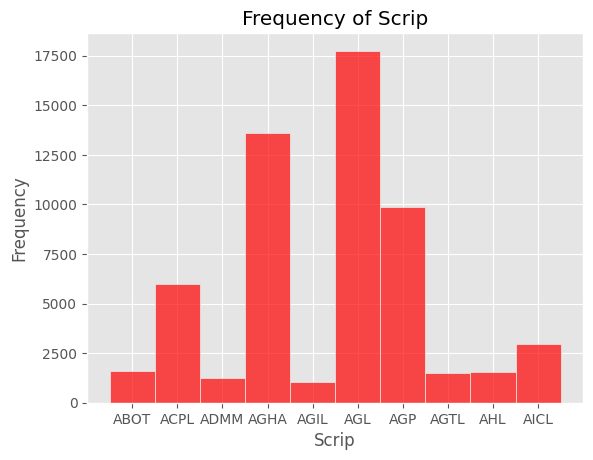

In [219]:
sns.histplot(train['Scrip'], bins='auto', kde=False, color='red', alpha=0.7, binwidth=1)
plt.xlabel('Scrip')
plt.ylabel('Frequency')
plt.title('Frequency of Scrip')
plt.show()

In [220]:
train.head()

,ID,Scrip,Datetime,Price,Volume,Open_daily,LDCP,Year,Month,Day,Quarter,DayOfWeek,Hour
0,2429,ABOT,2023-01-02 18:00:00,460.53,7500,456.14,463.31,2023,1,2,1,0,18
1,2430,ABOT,2023-01-03 18:00:00,450.20,10400,455.00,460.53,2023,1,3,1,1,18
2,2431,ABOT,2023-01-04 18:00:00,450.00,3350,450.00,450.20,2023,1,4,1,2,18
3,2432,ABOT,2023-01-05 18:00:00,444.69,11200,445.00,450.00,2023,1,5,1,3,18
4,2433,ABOT,2023-01-06 18:00:00,438.00,8900,444.00,444.69,2023,1,6,1,4,18


### <div style="padding:20px;color:white;margin:0;font-size:100%;text-align:left;display:fill;border-radius:5px;background-color:#663100;overflow:hidden"> Volume of Sales </div>

_Volume is the amount of an asset or security that changes hands over some period of time, often over the course of a day. For instance, the stock trading volume would refer to the number of shares of security traded between its daily open and close. Trading volume, and changes to volume over the course of time, are important inputs for technical traders._

This analysis aims to provide insights into the trading volume patterns of different stocks across various time scales. It visualizes the trading volume data for each stock at different granularities, including yearly, quarterly, monthly, day-wise, day-of-the-week-wise, and hourly levels.

- By examining the yearly volume, one can identify the overall annual trading activity for each stock, which can be useful for assessing the stock's liquidity and popularity among investors.

- The quarterly and monthly volume visualizations can reveal seasonal patterns or trends in trading activity, potentially influenced by factors such as earnings reports, market conditions, or investor sentiment.

- The day-wise volume analysis can highlight specific days or periods of heightened or diminished trading activity, which may be associated with significant events, news, or market movements.

- The day-of-the-week-wise volume breakdown can uncover any patterns or biases in trading activity based on the day of the week, which could be valuable information for traders and market participants.

- The hourly volume analysis can provide insights into intraday trading patterns, allowing the identification of peak trading hours or periods of heightened volatility.

By presenting these visualizations, one can gain a comprehensive understanding of the trading volume dynamics for each stock, enabling more informed decisions regarding investment strategies, risk management, or identifying potential trading opportunities.


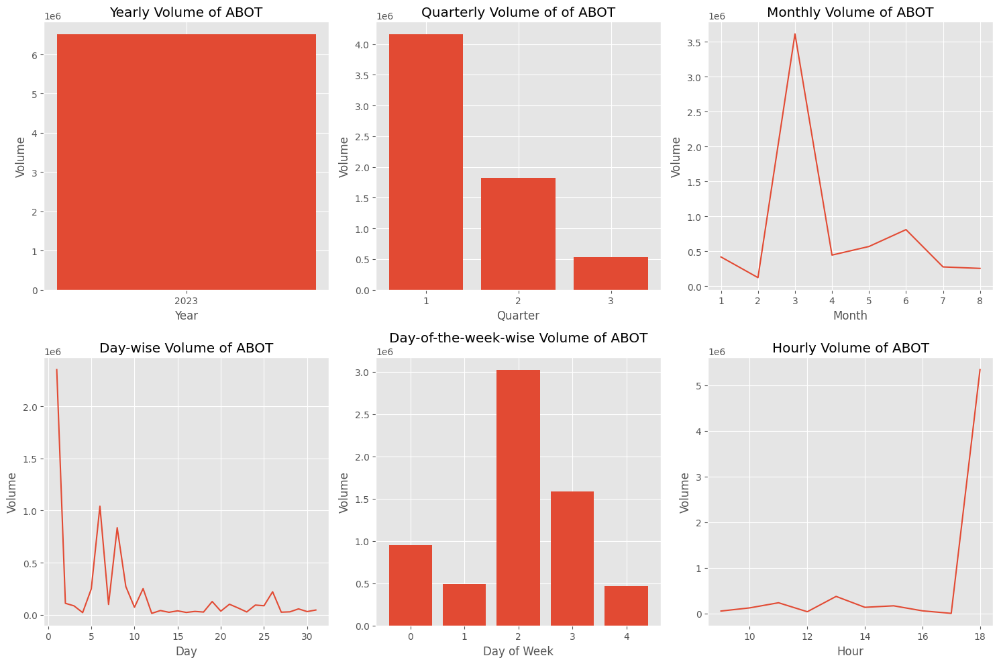

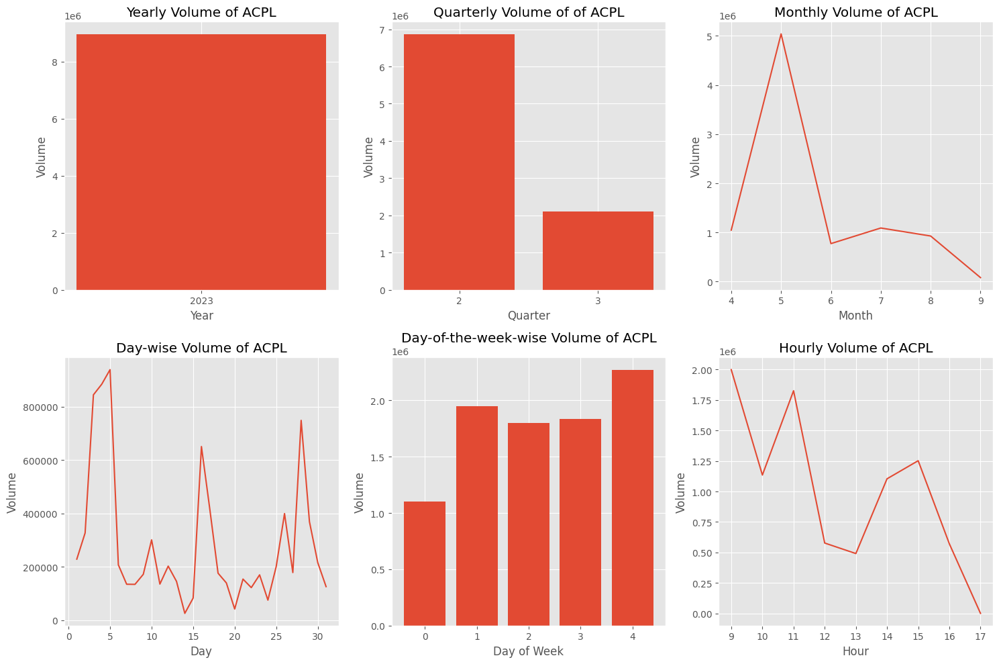

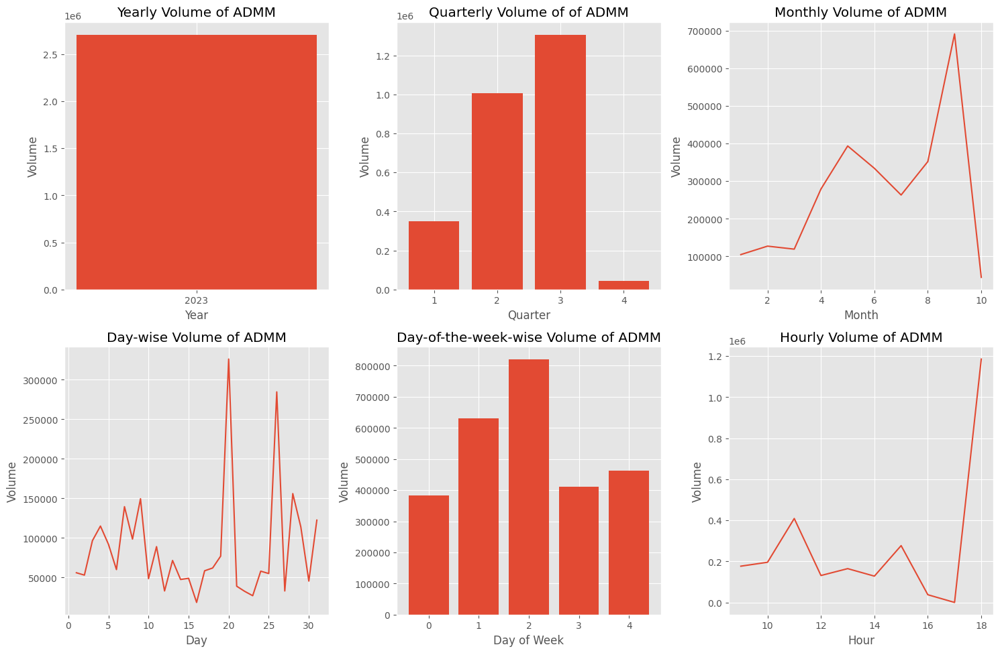

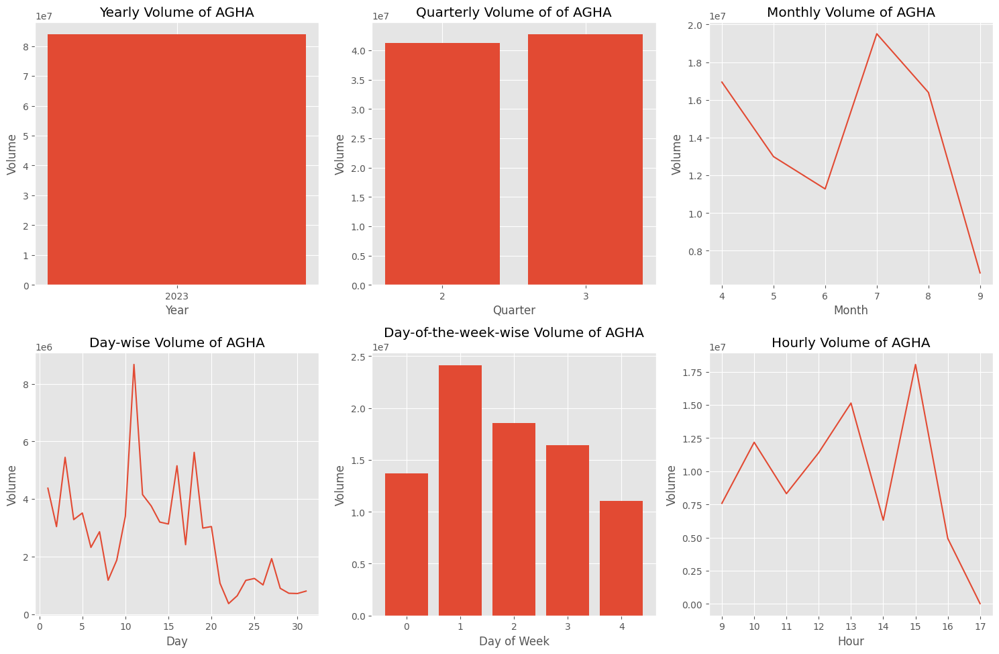

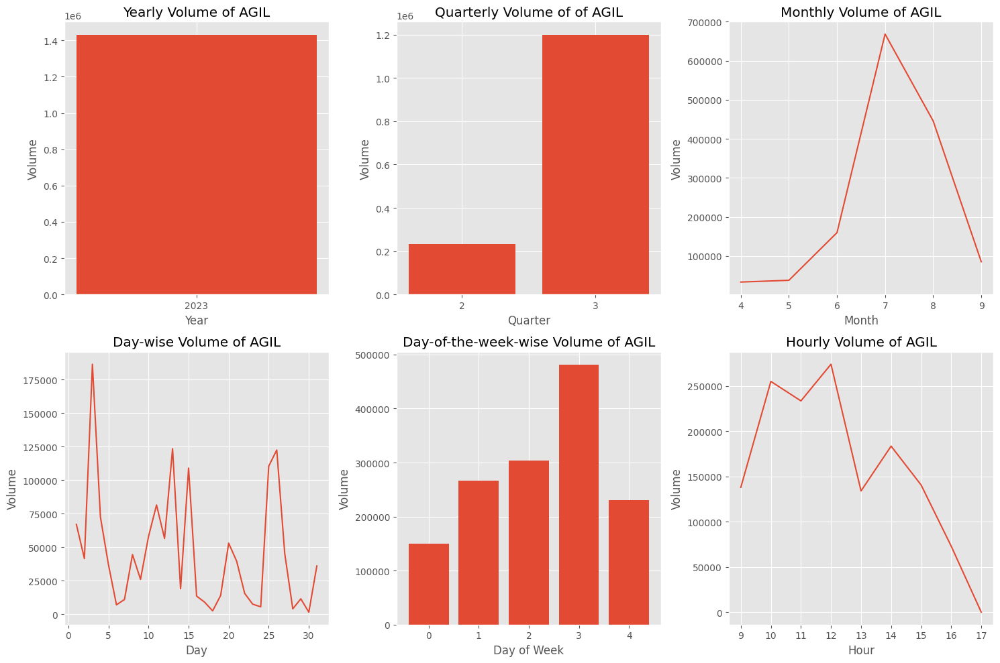

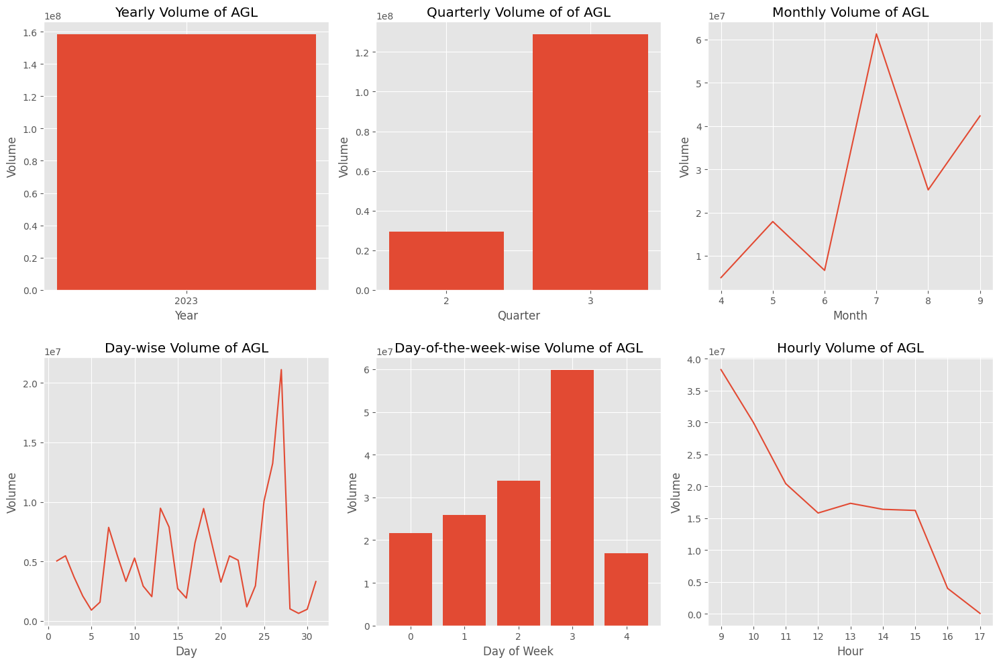

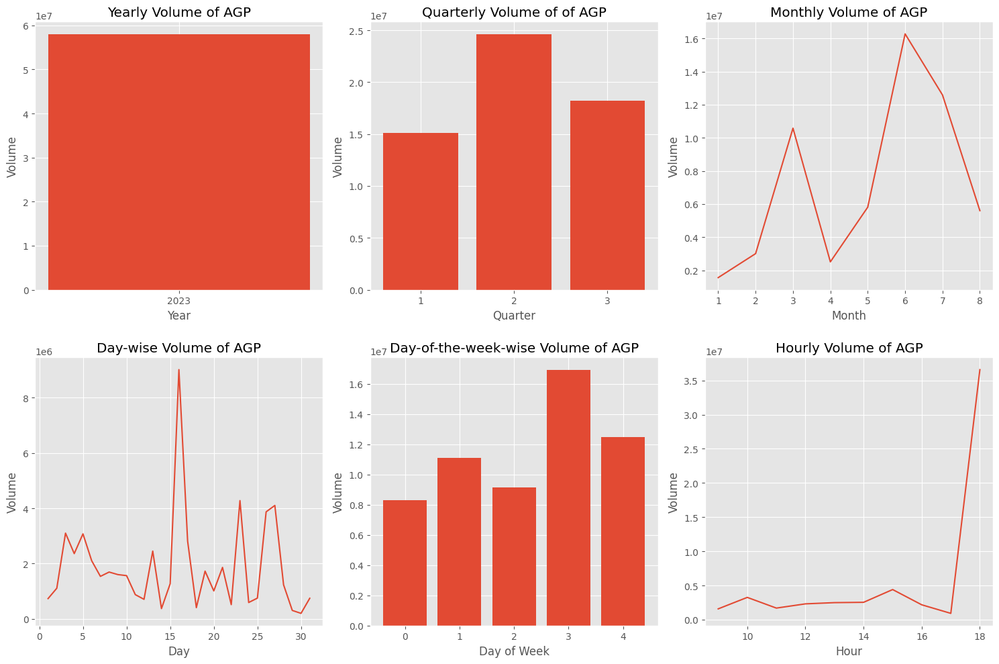

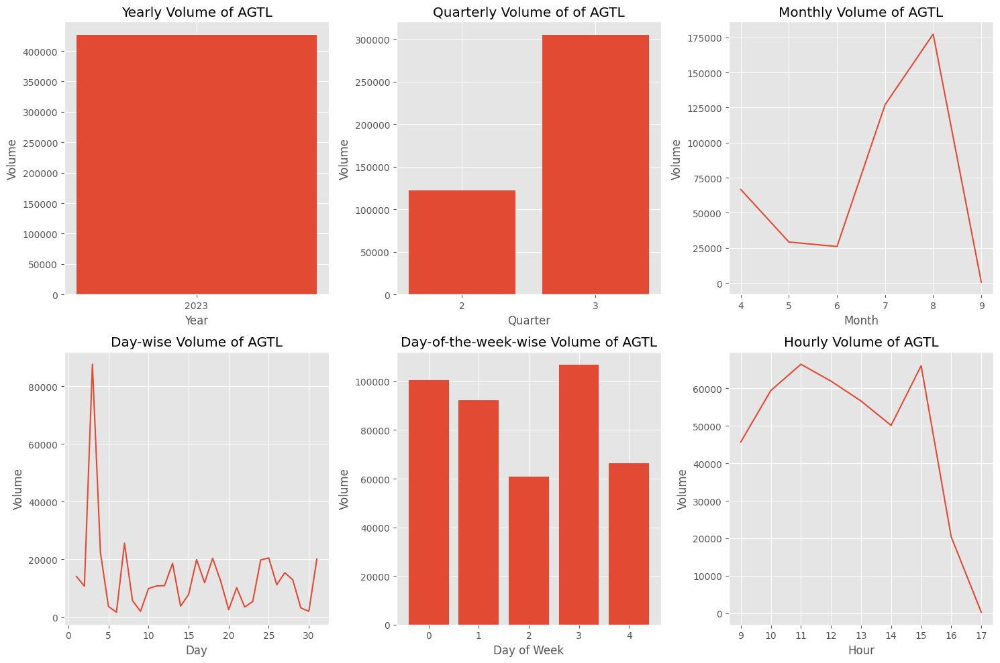

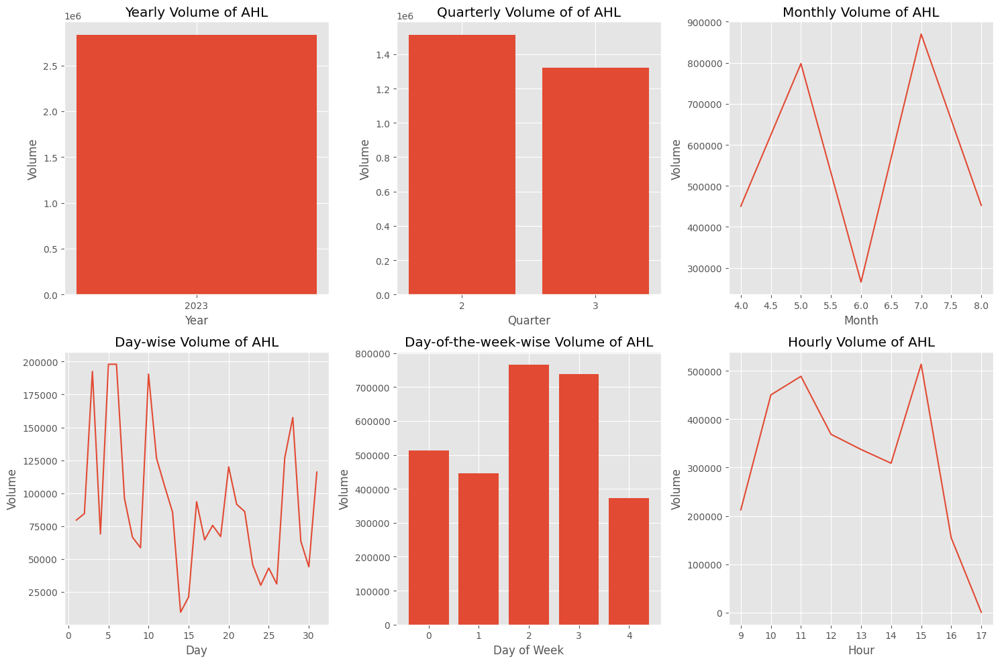

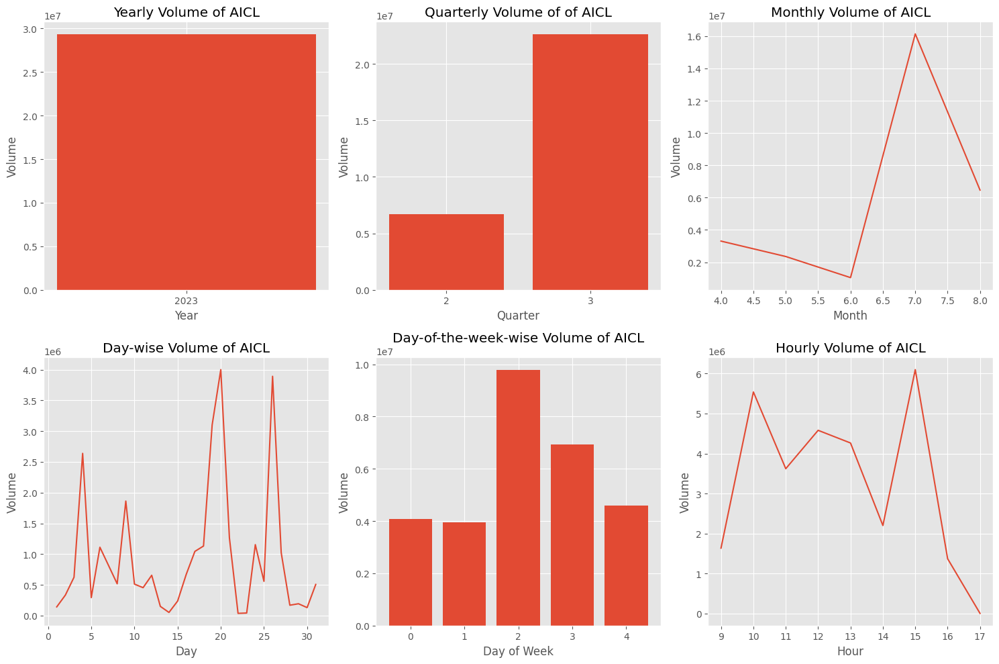

In [221]:


for i, name in enumerate(stocks, 1):
    company = train[train['Scrip'] == name].set_index('Datetime')
    plt.figure(figsize=(15, 10))
    plt.subplots_adjust(hspace=0.5)
    name=company['Scrip'][0]
    yearly_volume = company.groupby('Year')['Volume'].sum().reset_index()

    # Quarterly
    quarterly_volume = company.groupby(['Year', 'Quarter'])['Volume'].sum().reset_index()

    # Monthly
    monthly_volume = company.groupby(['Year', 'Month'])['Volume'].sum().reset_index()

    # Day-wise
    day_volume = company.groupby(['Day'])['Volume'].sum().reset_index()

    # Day-of-the-week-wise
    dayofweek_volume = company.groupby('DayOfWeek')['Volume'].sum().reset_index()

    # Hourly
    hourly_volume = company.groupby('Hour')['Volume'].sum().reset_index()

    # Yearly
    plt.subplot(2, 3, 1)
    plt.bar(yearly_volume['Year'], yearly_volume['Volume'])
    plt.xlabel('Year')
    plt.ylabel('Volume')
    plt.title('Yearly Volume'+' of '+name)
    plt.xticks(yearly_volume['Year'])
               #str(company['Scrip'][0]))


    # Quarterly
    plt.subplot(2, 3, 2)
    plt.bar(quarterly_volume['Quarter'], quarterly_volume['Volume'])
    plt.xlabel('Quarter')
    plt.ylabel('Volume')
    plt.title('Quarterly Volume of'+' of '+name)

    # Monthly
    plt.subplot(2, 3, 3)
    plt.plot(monthly_volume['Month'], monthly_volume['Volume'])
    plt.xlabel('Month')
    plt.ylabel('Volume')
    plt.title('Monthly Volume'+' of '+name)
    # Day-wise
    plt.subplot(2, 3, 4)
    plt.plot(day_volume['Day'], day_volume['Volume'])
    plt.xlabel('Day')
    plt.ylabel('Volume')
    plt.title('Day-wise Volume'+' of '+name)
    # Day-of-the-week-wise
    plt.subplot(2, 3, 5)
    plt.bar(dayofweek_volume['DayOfWeek'], dayofweek_volume['Volume'])
    plt.xlabel('Day of Week')
    plt.ylabel('Volume')
    plt.title('Day-of-the-week-wise Volume'+' of '+name)
    # Hourly
    plt.subplot(2, 3, 6)
    plt.plot(hourly_volume['Hour'], hourly_volume['Volume'])
    plt.xlabel('Hour')
    plt.ylabel('Volume')
    plt.title('Hourly Volume'+' of '+name)

    plt.tight_layout()
    plt.show()




### <div style="padding:20px;color:white;margin:0;font-size:100%;text-align:left;display:fill;border-radius:5px;background-color:#1a0c00;overflow:hidden"> Closing Price </div>

_The closing price is the last price at which the stock is traded during the regular trading day. A stock’s closing price is the standard benchmark used by investors to track its performance over time._

Here we are analyzing the closing prices according to:

- Yearly
- Quarterly
- Monthly
- Day of the month
- Day of the week
- Hourly


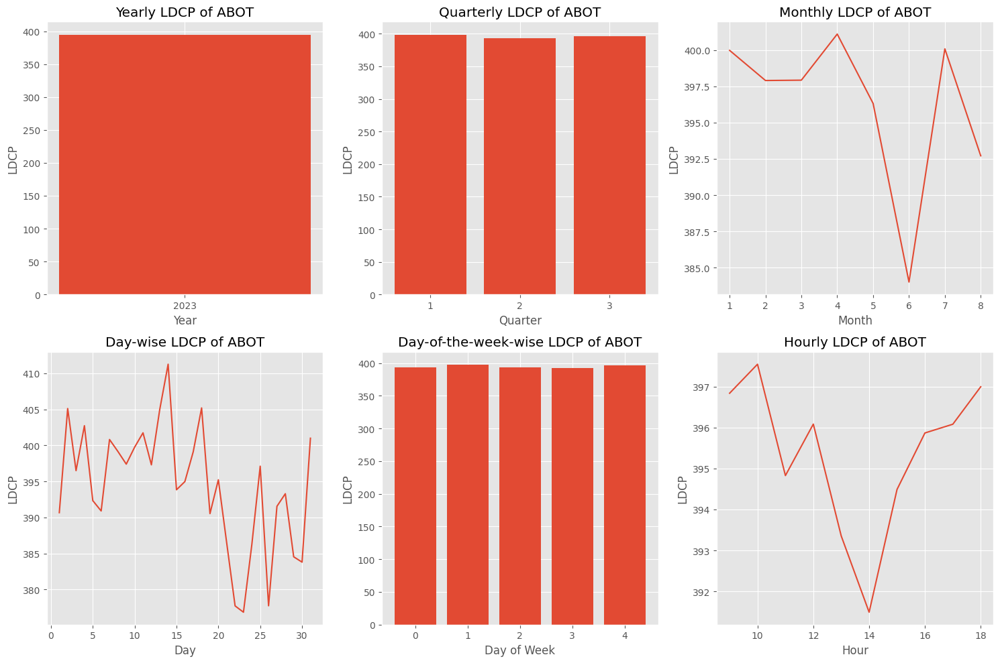

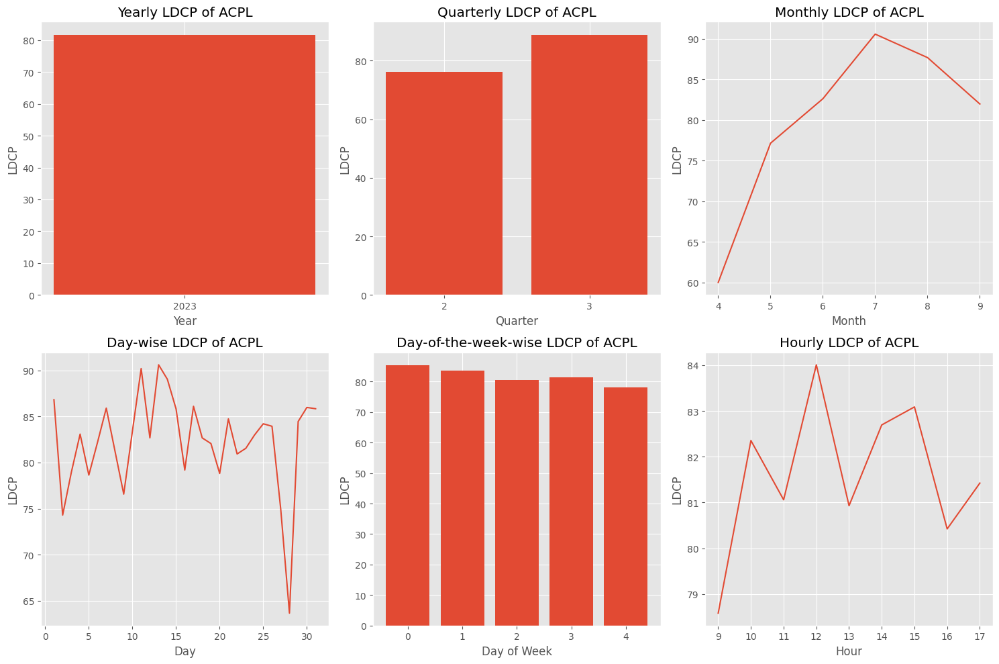

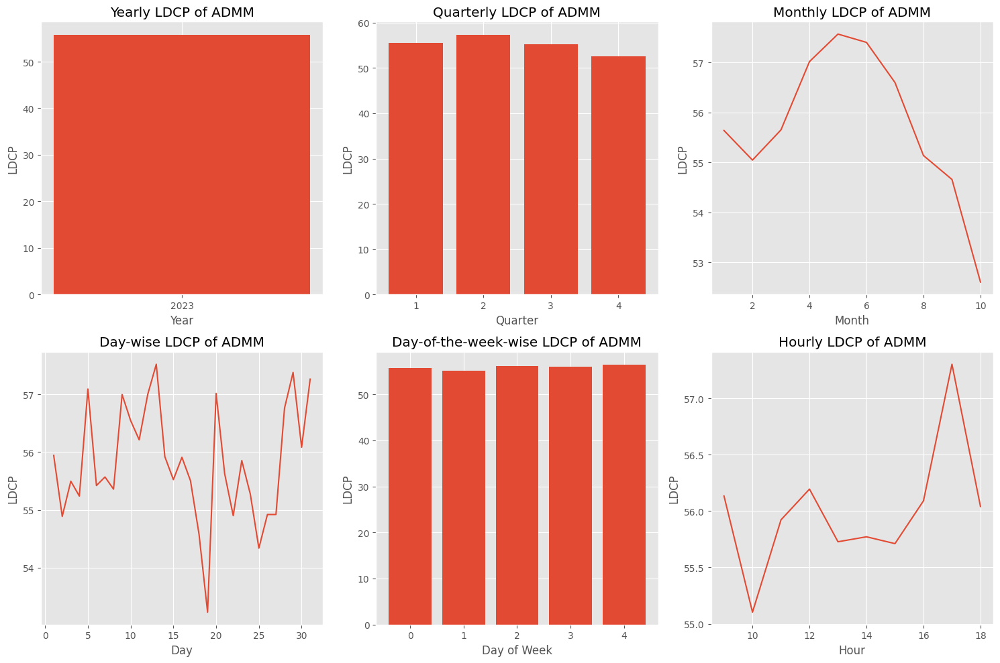

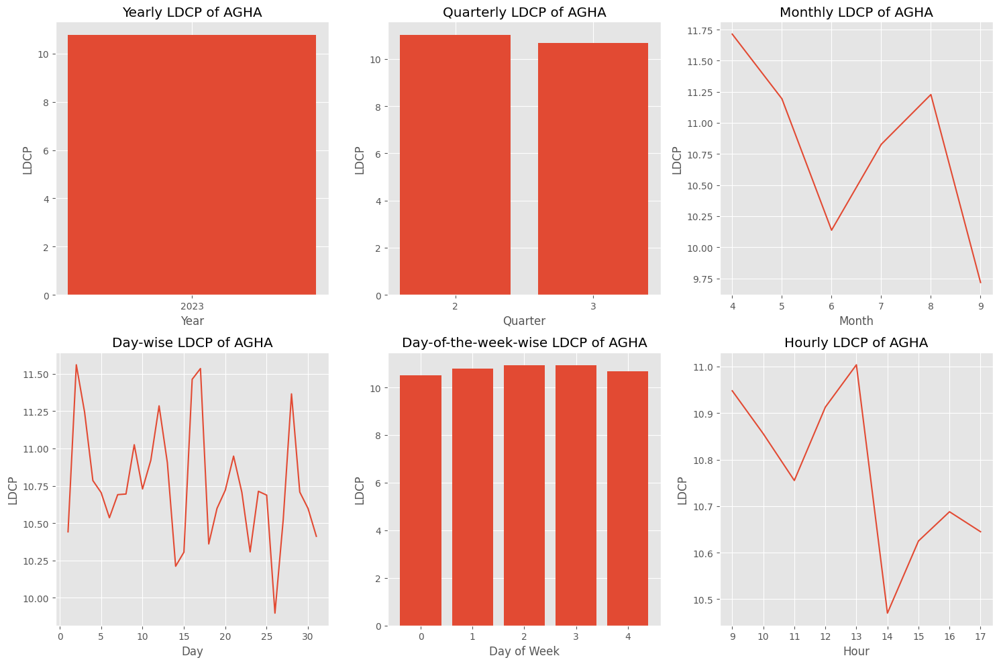

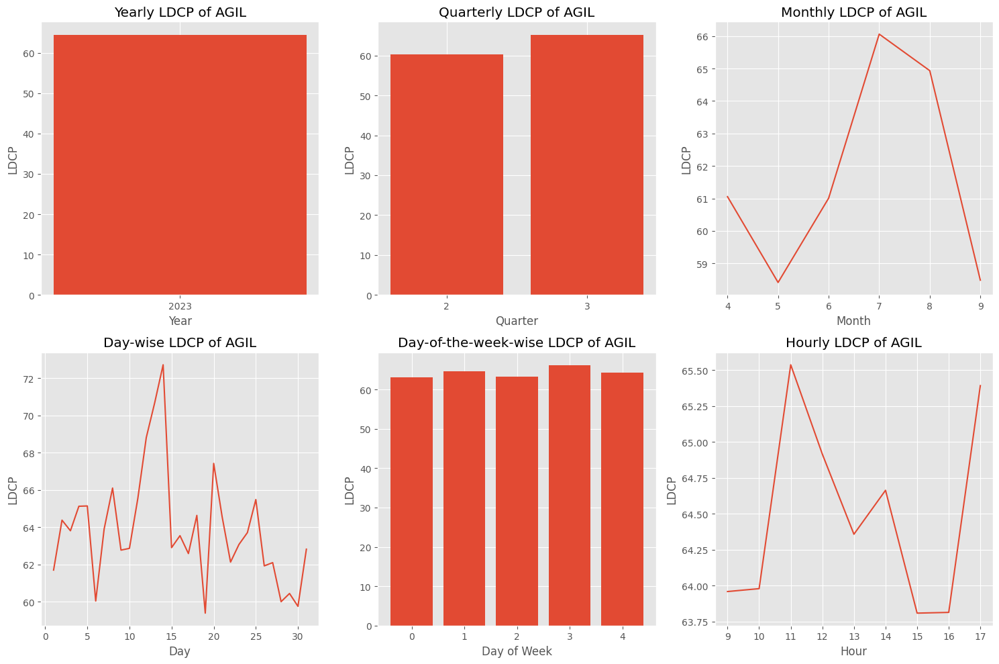

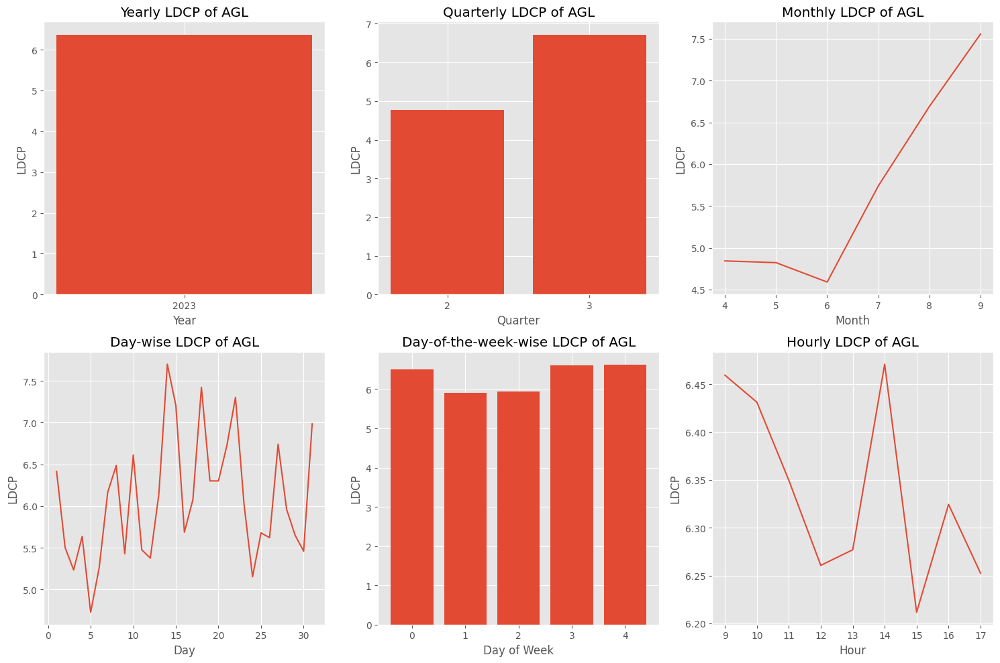

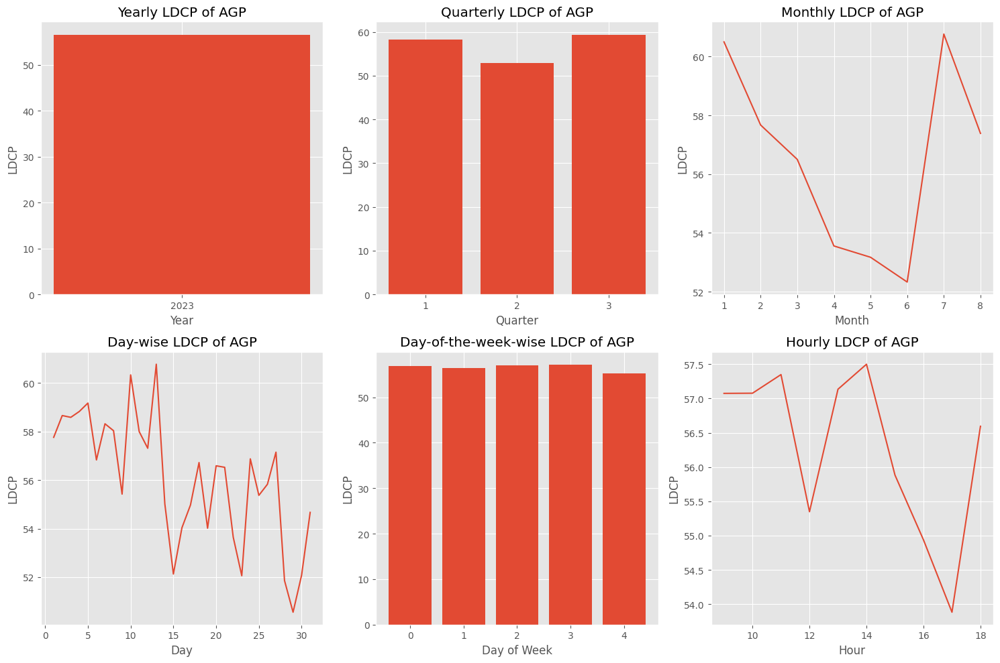

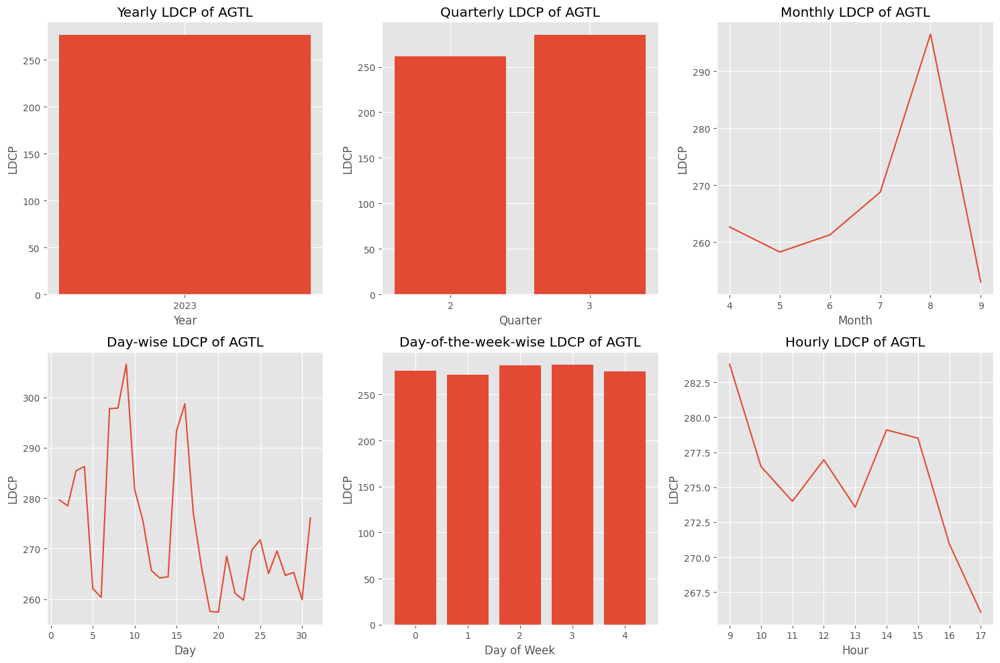

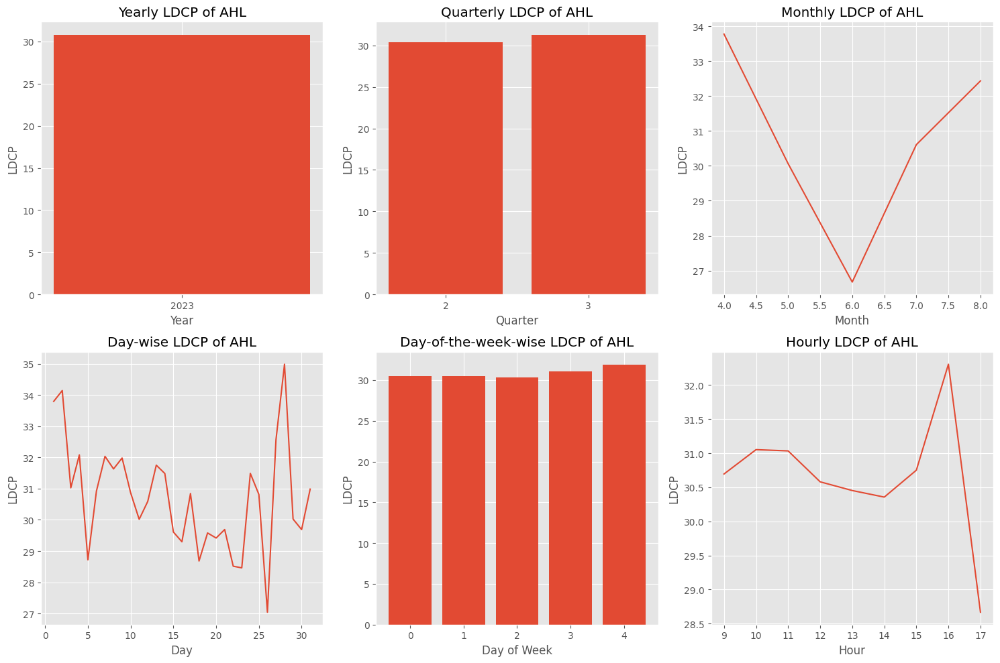

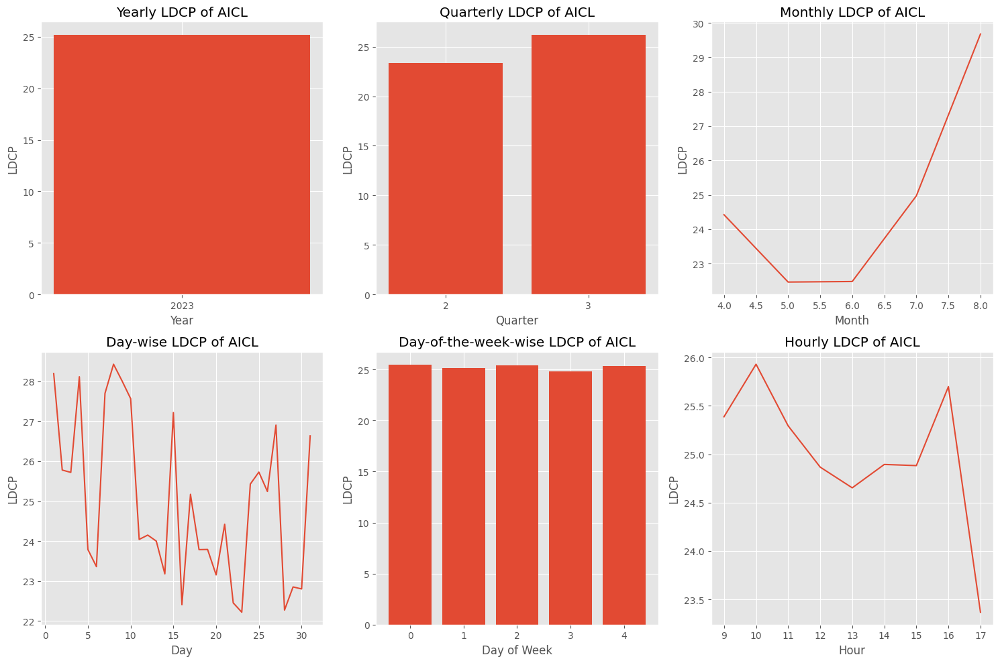

In [222]:


for i, name in enumerate(stocks, 1):
    company = train[train['Scrip'] == name].set_index('Datetime')
    plt.figure(figsize=(15, 10))
    plt.subplots_adjust(hspace=0.5)
    name=company['Scrip'][0]

    yearly_volume = company.groupby('Year')['LDCP'].mean().reset_index()

    # Quarterly
    quarterly_volume = company.groupby(['Year', 'Quarter'])['LDCP'].mean().reset_index()

    # Monthly
    monthly_volume = company.groupby(['Year', 'Month'])['LDCP'].mean().reset_index()

    # Day-wise
    day_volume = company.groupby(['Day'])['LDCP'].mean().reset_index()

    # Day-of-the-week-wise
    dayofweek_volume = company.groupby('DayOfWeek')['LDCP'].mean().reset_index()

    # Hourly
    hourly_volume = company.groupby('Hour')['LDCP'].mean().reset_index()

    # Yearly
    plt.subplot(2, 3, 1)
    plt.bar(yearly_volume['Year'], yearly_volume['LDCP'])
    plt.xlabel('Year')
    plt.ylabel('LDCP')
    plt.title('Yearly LDCP'+' of '+name)
    plt.xticks(yearly_volume['Year'])


    # Quarterly
    plt.subplot(2, 3, 2)
    plt.bar(quarterly_volume['Quarter'], quarterly_volume['LDCP'])
    plt.xlabel('Quarter')
    plt.ylabel('LDCP')
    plt.title('Quarterly LDCP'+' of '+name)

    # Monthly
    plt.subplot(2, 3, 3)
    plt.plot(monthly_volume['Month'], monthly_volume['LDCP'])
    plt.xlabel('Month')
    plt.ylabel('LDCP')
    plt.title('Monthly LDCP'+' of '+name)

    # Day-wise
    plt.subplot(2, 3, 4)
    plt.plot(day_volume['Day'], day_volume['LDCP'])
    plt.xlabel('Day')
    plt.ylabel('LDCP')
    plt.title('Day-wise LDCP'+' of '+name)

    # Day-of-the-week-wise
    plt.subplot(2, 3, 5)
    plt.bar(dayofweek_volume['DayOfWeek'], dayofweek_volume['LDCP'])
    plt.xlabel('Day of Week')
    plt.ylabel('LDCP')
    plt.title('Day-of-the-week-wise LDCP'+' of '+name)

    # Hourly
    plt.subplot(2, 3, 6)
    plt.plot(hourly_volume['Hour'], hourly_volume['LDCP'])
    plt.xlabel('Hour')
    plt.ylabel('LDCP')
    plt.title('Hourly LDCP'+' of '+name)

    plt.tight_layout()
    plt.show()





### <div style="padding:20px;color:white;margin:0;font-size:100%;text-align:left;display:fill;border-radius:5px;background-color:#1a0c00;overflow:hidden">**RSI**


Determine if a stock is overbought or oversold to time entry and exit points.

**Explanation:**
_RSI measures the magnitude of recent price changes to evaluate overbought or oversold conditions in the price of a stock._

**Better Values:**

- RSI values above 70 suggest that the stock might be overbought, indicating a selling opportunity.
- RSI values below 30 suggest that the stock might be oversold, indicating a buying opportunity.

**Worse Values:**

- When RSI values are between 30 and 70, the stock is typically considered to be in a neutral zone, which might not provide strong buy or sell signals.


In [223]:
import warnings
warnings.filterwarnings('ignore')

In [224]:

def rsi(values):
    up = values[values>0].mean()
    down = -1*values[values<0].mean()
    return 100 * up / (up + down)

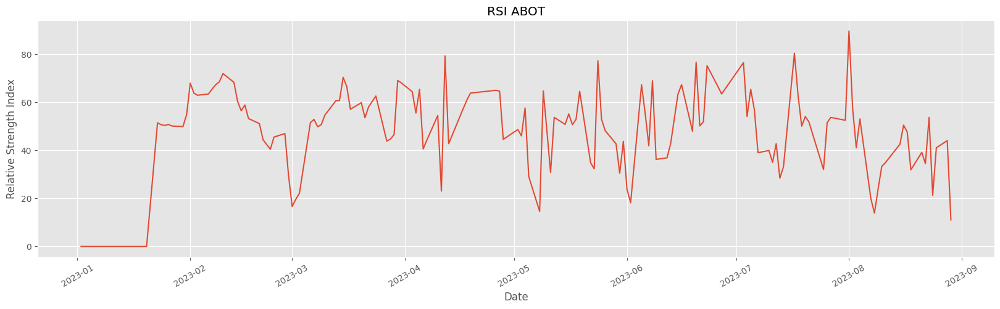

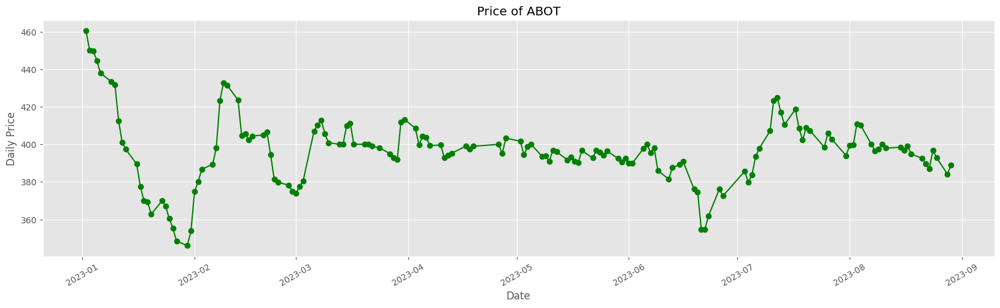

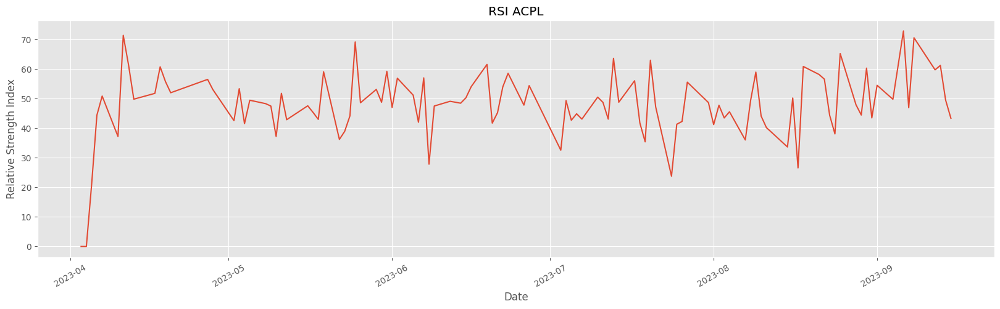

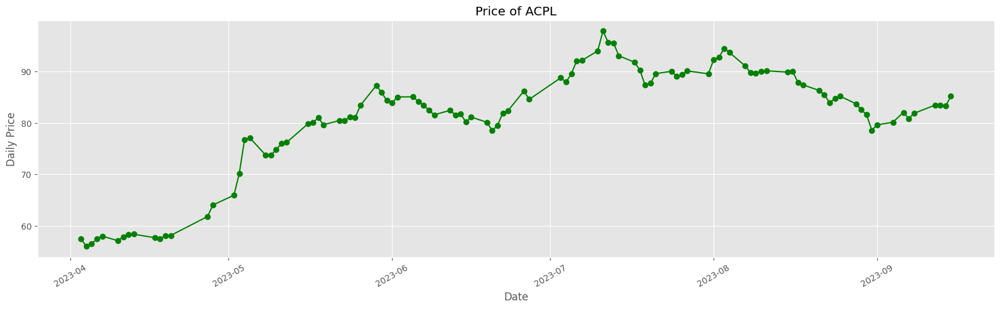

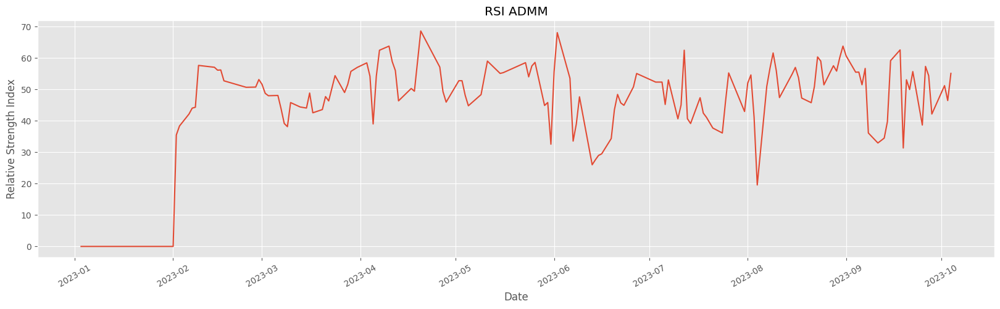

...

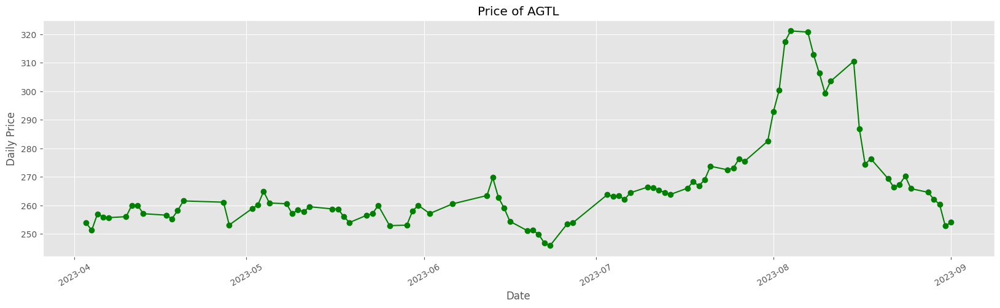

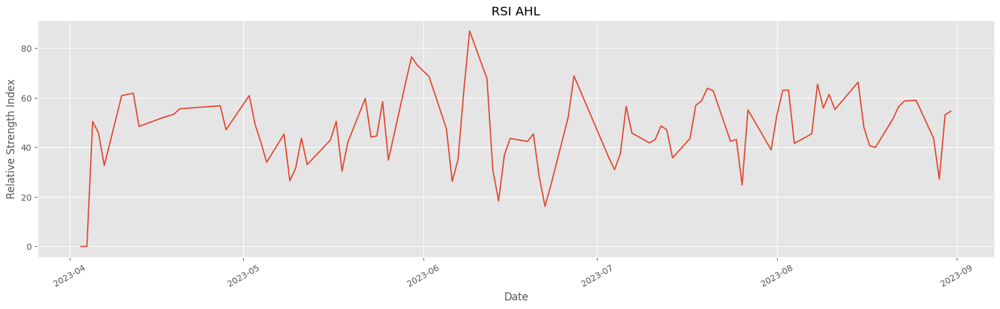

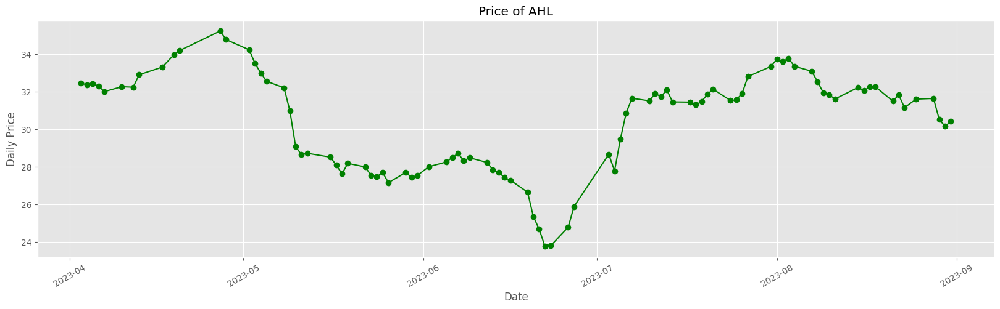

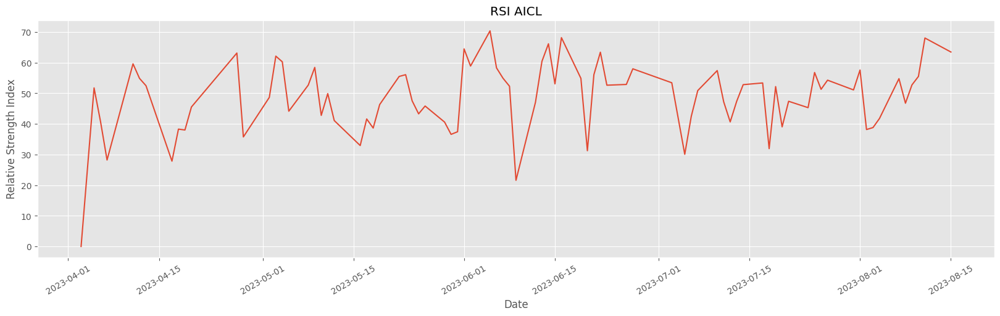

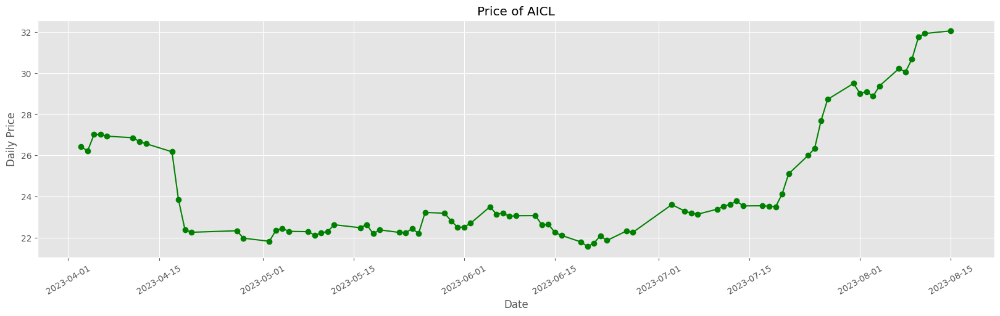

In [225]:

for i, name in enumerate(stocks, 1):
    company = train[train['Scrip'] == name].set_index('Datetime')
    plt.figure(figsize=(20, 5))
    company['Date'] = company.index.date



    company['Momentum_1D'] = (company['Price']-company['Price'].shift(1)).fillna(0)
    company['RSI_14D'] = company['Momentum_1D'].rolling(center=False, window=14).apply(rsi).fillna(0)
    daily_rsi = company.groupby('Date')['RSI_14D'].mean().reset_index()  # For mean
    

    plt.plot(daily_rsi['Date'], daily_rsi['RSI_14D'])

    plt.title('RSI '+str(company['Scrip'][0]))
    plt.xlabel("Date")
    plt.ylabel("Relative Strength Index")
    plt.xticks(rotation=30)


    plt.figure(figsize=(20, 5))

    daily_price = company.groupby('Date')['Price'].mean().reset_index()  # For mean
    plt.plot(daily_price['Date'], daily_price['Price'],color="g",marker="o")

    plt.title('Price of '+str(company['Scrip'][0]))
    plt.xlabel("Date")
    plt.ylabel("Daily Price")
    plt.xticks(rotation=30)
    

    


### <div style="padding:20px;color:white;margin:0;font-size:100%;text-align:left;display:fill;border-radius:5px;background-color:#1a0c00;overflow:hidden">**On Balance Volume (OBV):**


Track volume changes to predict future price movements.
**Explanation:**
OBV uses volume flow to predict price changes. It’s a cumulative total of volume, adding volume on up days and subtracting volume on down days.

**Better Values:**

An increasing OBV indicates that volume is flowing into the stock, suggesting potential upward price movement, which is a good sign for buying.
A decreasing OBV indicates that volume is flowing out of the stock, suggesting potential downward price movement, which is a good sign for selling.

**Worse Values:**

If the price moves up while OBV moves down, it could indicate a weak rally with insufficient volume support, suggesting caution.


In [226]:
def calculate_obv(df):
    df['Price_Change'] = df['Price'].diff()
    df['Direction'] = df['Price_Change'].apply(lambda x: 1 if x > 0 else (-1 if x < 0 else 0))
    df['OBV'] = (df['Volume'] * df['Direction']).cumsum()
    return df

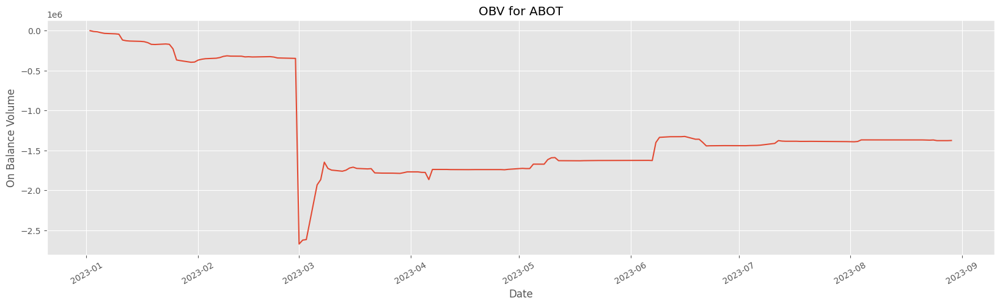

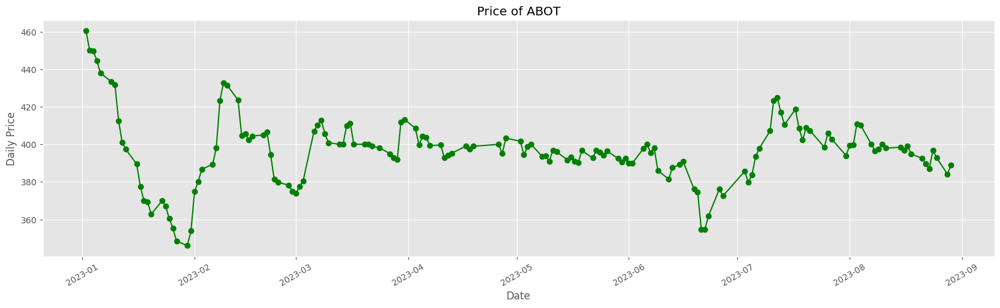

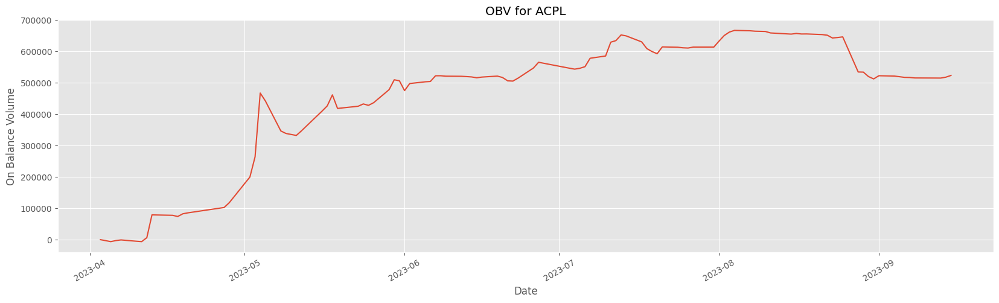

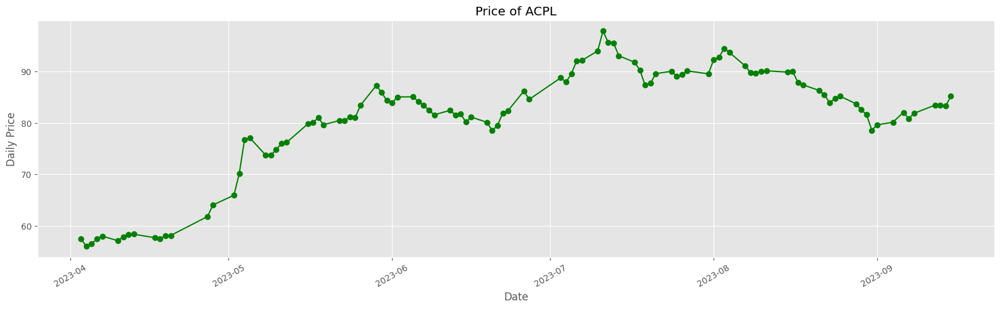

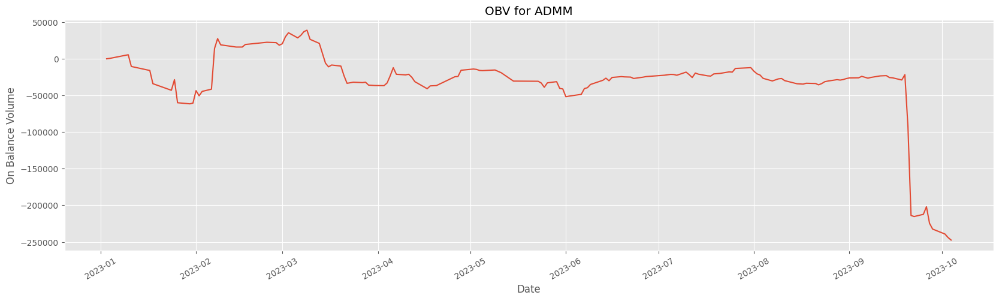

...

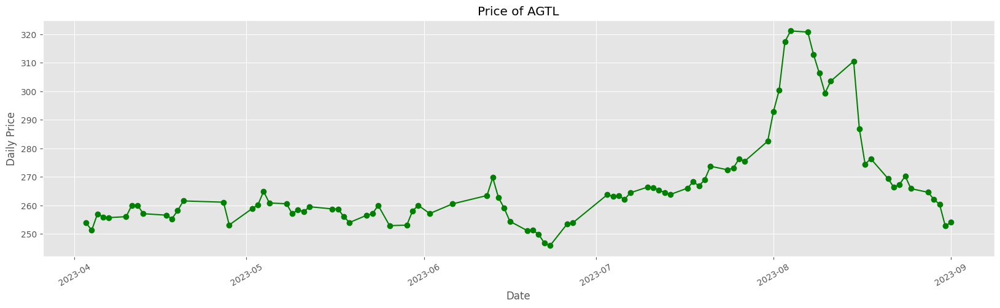

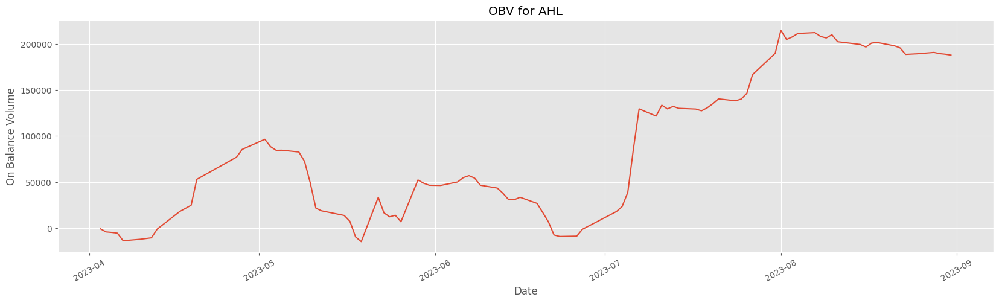

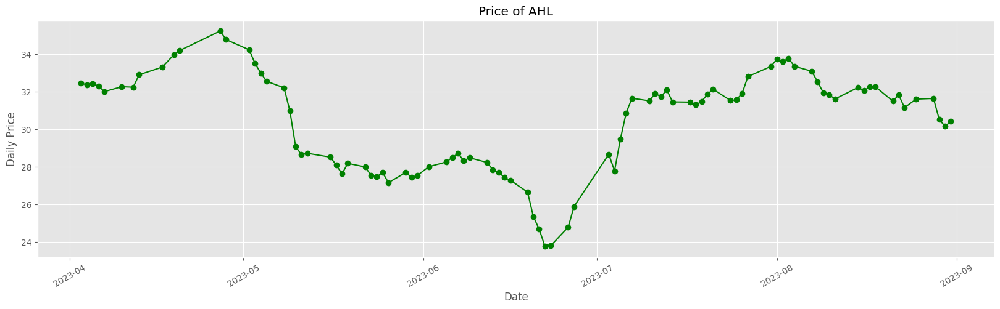

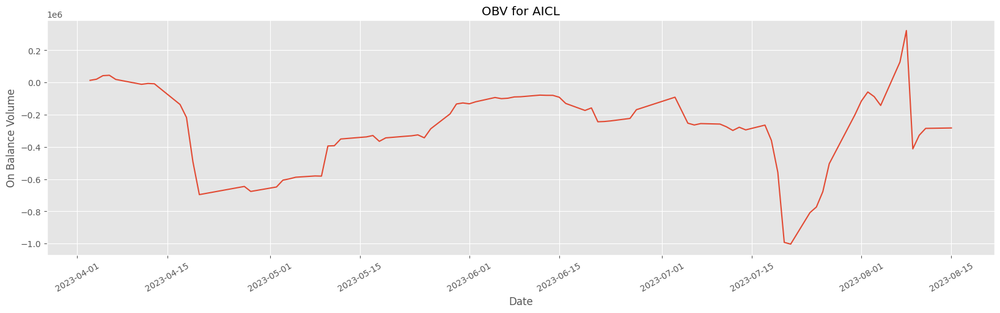

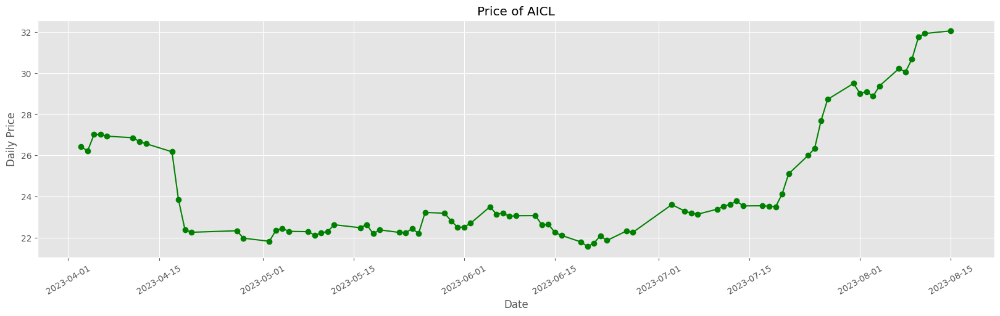

In [227]:

for i, name in enumerate(stocks, 1):
    company = train[train['Scrip'] == name].set_index('Datetime')
    plt.figure(figsize=(20, 5))
    company['Date'] = company.index.date



    company= calculate_obv(company)
    
    daily_obv = company.groupby('Date')['OBV'].mean().reset_index()  # For mean
    

    plt.plot(daily_obv['Date'], daily_obv['OBV'])

    plt.title("OBV for " +str(company['Scrip'][0]))

    plt.xlabel("Date")
    plt.ylabel("On Balance Volume")
    plt.xticks(rotation=30)

    plt.figure(figsize=(20, 5))

    daily_price = company.groupby('Date')['Price'].mean().reset_index()  # For mean
    plt.plot(daily_price['Date'], daily_price['Price'],color="g",marker="o")

    plt.title('Price of '+str(company['Scrip'][0]))
    plt.xlabel("Date")
    plt.ylabel("Daily Price")
    plt.xticks(rotation=30)
    





### <div style="padding:20px;color:white;margin:0;font-size:100%;text-align:left;display:fill;border-radius:5px;background-color:#1a0c00;overflow:hidden">**MACD**


Use to find if a stock is trading above or below its average price for the day.

**Explanation:**

_MACD is a trend-following indicator that shows the relationship between two moving averages of a stock’s price. It helps identify potential buy and sell signals._

**Better Values:**

- A positive MACD value (MACD line above the signal line) suggests upward momentum, indicating a buying opportunity.
- A negative MACD value (MACD line below the signal line) suggests downward momentum, indicating a selling opportunity.

**Worse Values:**

- When the MACD line crosses the signal line but without strong confirmation (low trading volume or erratic price movements), it can give false signals.


In [228]:
def calculate_macd(df, short_window=12, long_window=26, signal_window=9):
    df['12_ema'] = df['Price'].ewm(span=short_window, adjust=False).mean()
    df['26_ema'] = df['Price'].ewm(span=long_window, adjust=False).mean()
    df['MACD'] = df['12_ema'] - df['26_ema']
    df['Signal_Line'] = df['MACD'].ewm(span=signal_window, adjust=False).mean()
    return df


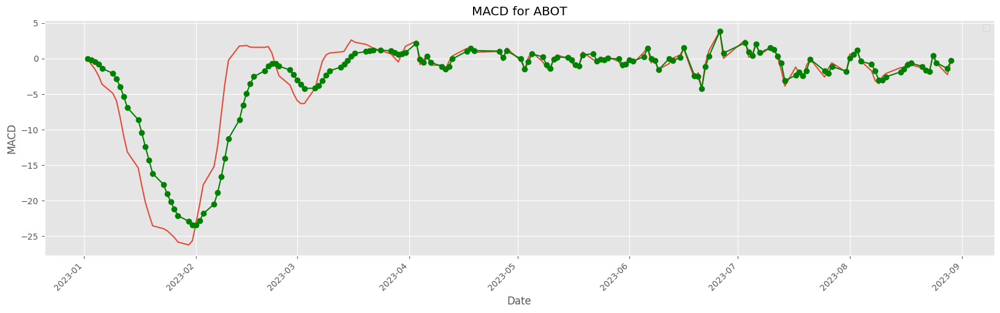

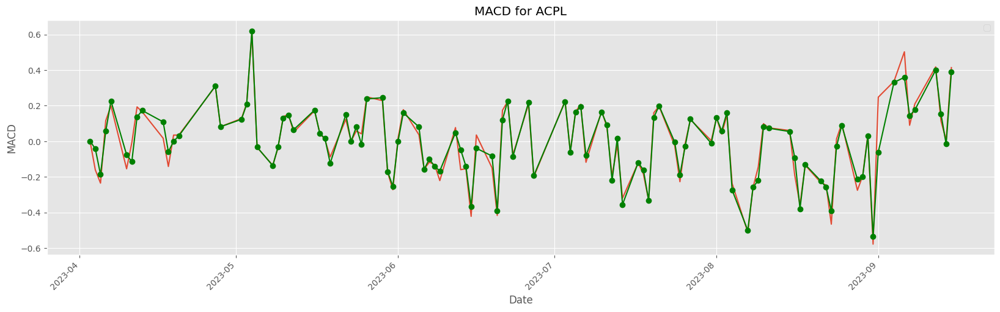

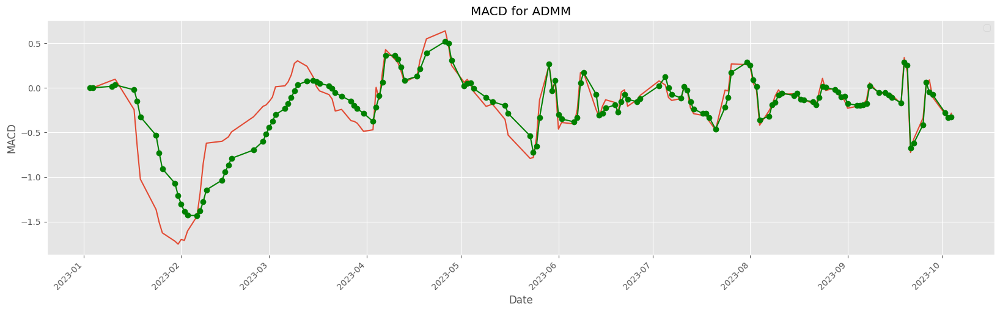

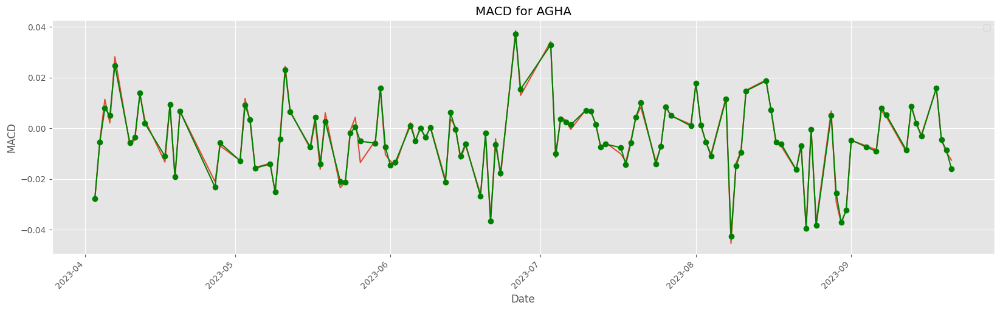

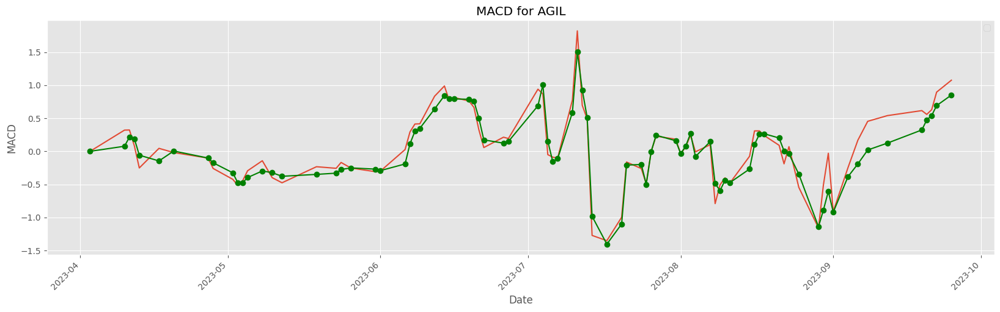

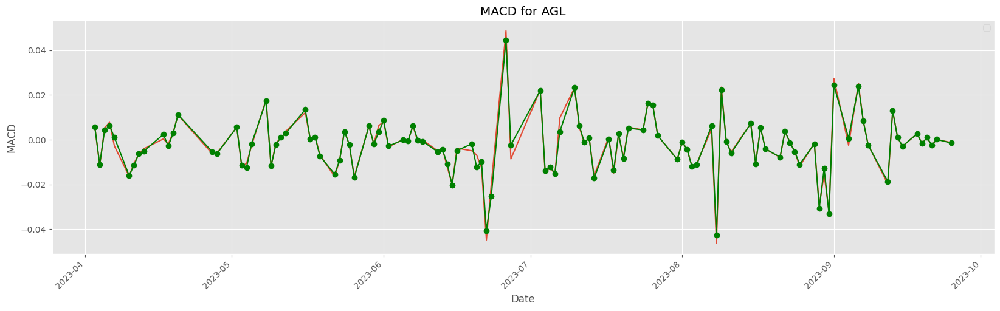

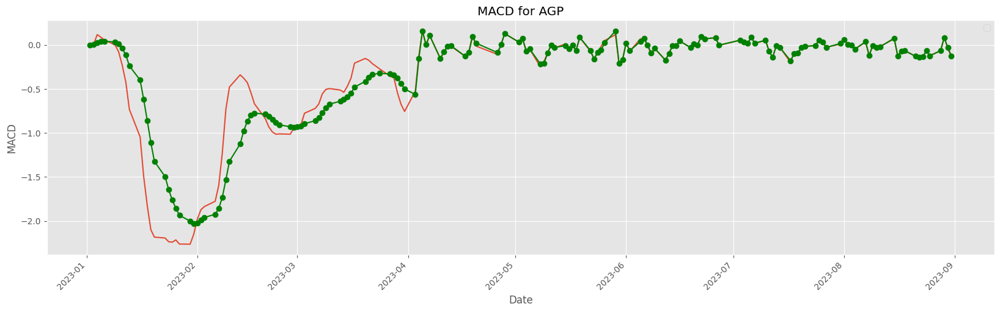

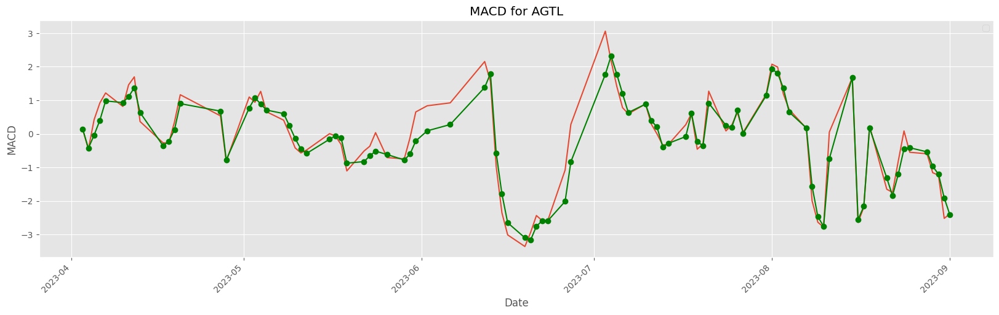

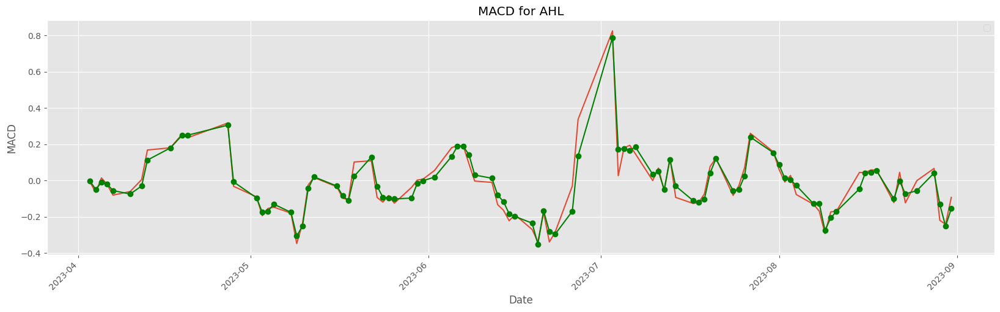

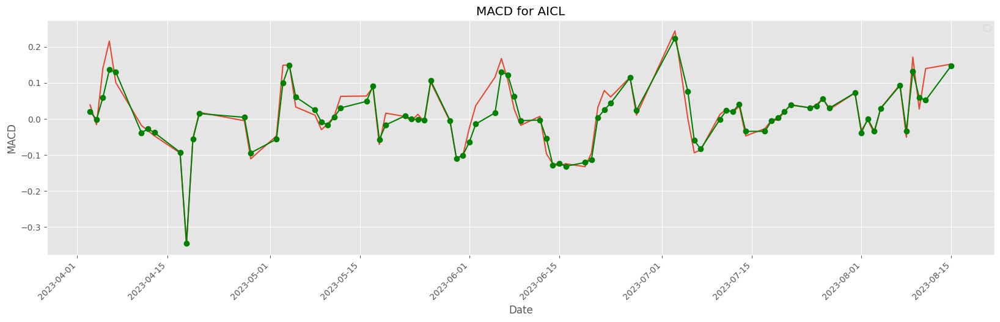

In [229]:

for i, name in enumerate(stocks, 1):
    company = train[train['Scrip'] == name].set_index('Datetime')
    plt.figure(figsize=(20, 5))
    company['Date'] = company.index.date



    company= calculate_macd(company)
    
    daily_MACD = company.groupby('Date')['MACD'].mean().reset_index()  
    

    plt.plot(daily_MACD['Date'], daily_MACD['MACD'])

    plt.title("MACD for " +str(company['Scrip'][0]))

    plt.xlabel("Date")
    plt.ylabel("MACD")


    daily_price = company.groupby('Date')['Signal_Line'].mean().reset_index()  # For mean
    plt.plot(daily_price['Date'], daily_price['Signal_Line'],color="g",marker="o")

    plt.xticks(rotation=45, ha='right')
    plt.legend()
    
    plt.show()
    





### <div style="padding:20px;color:white;margin:0;font-size:100%;text-align:left;display:fill;border-radius:5px;background-color:#1a0c00;overflow:hidden">**VWAP**


Use to find if a stock is trading above or below its average price for the day.

**Explanation:**
_VWAP represents the average price a stock has traded at throughout the day, weighted by volume. It's often used as a benchmark for comparing the current price of a stock._

**Better Values:**

- When the current price is below the VWAP, it might be considered a good buying opportunity, suggesting the stock is undervalued based on the day's trading.
- When the current price is above the VWAP, it indicates a potential selling opportunity, as the stock may be overvalued.

**Worse Values:**

- If the price deviates significantly from the VWAP without any supporting volume, it might indicate false signals or potential market manipulation.


In [230]:

def calculate_vwap(df):
    # df['VWAP'] = (df['Price'] * df['Volume']).cumsum() / df['Volume'].cumsum()
    df['Cumulative_Price_Volume'] = (df['Price'] * df['Volume']).cumsum()
    df['Cumulative_Volume'] = df['Volume'].cumsum()
    df['VWAP'] = df['Cumulative_Price_Volume'] / df['Cumulative_Volume']
    return df
def calculate_roc(df, period=14):
    df['ROC'] = df['Price'].diff(periods=period) / df['Price'].shift(periods=period) * 100
    return df

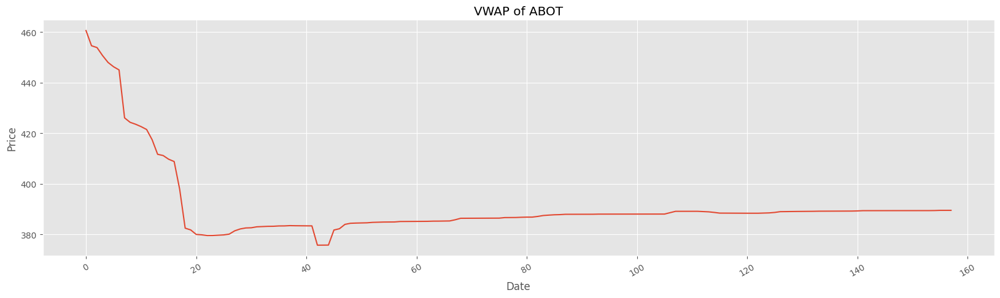

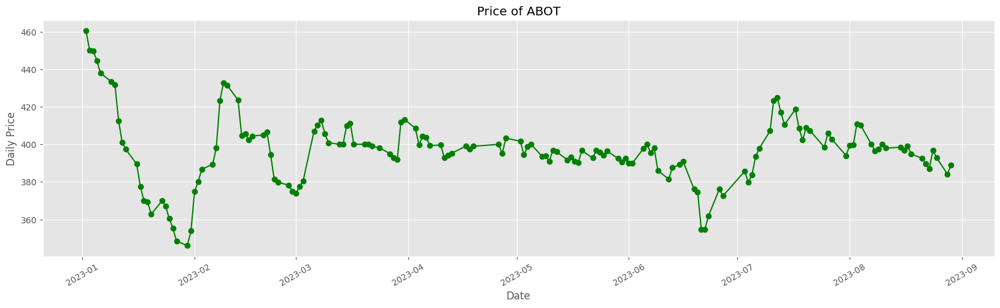

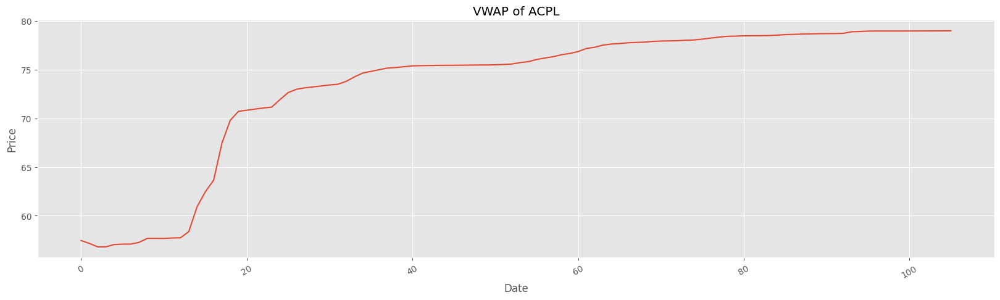

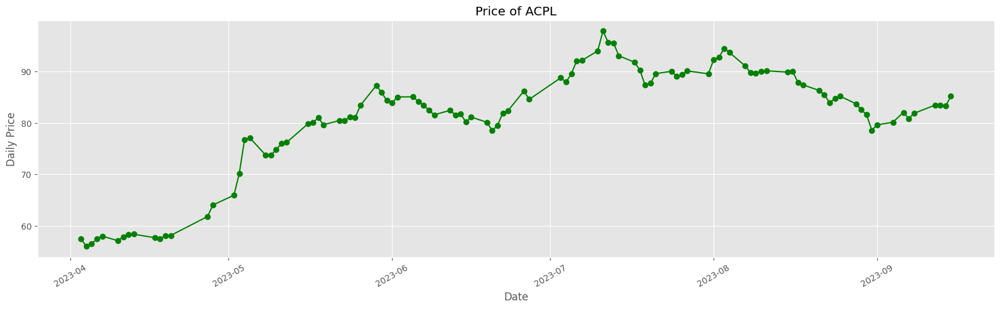

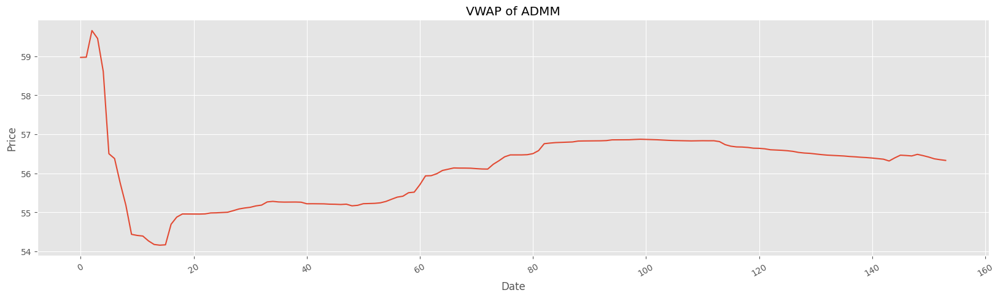

...

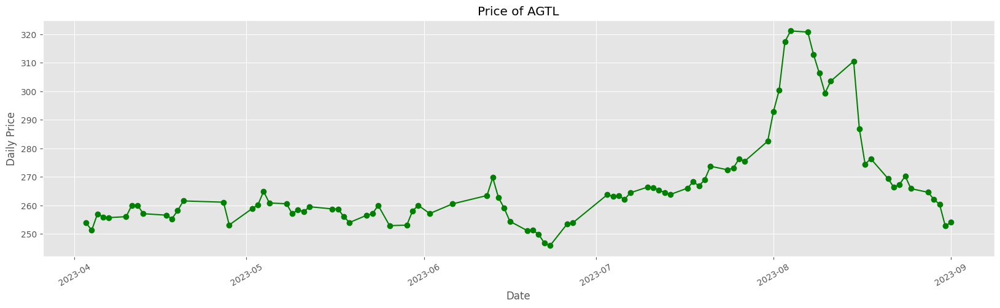

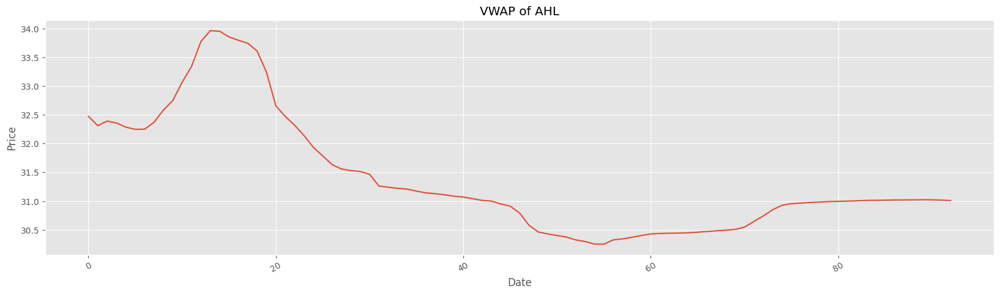

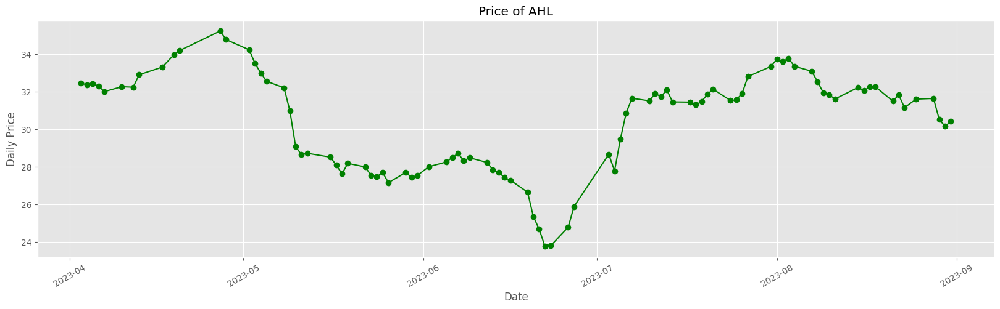

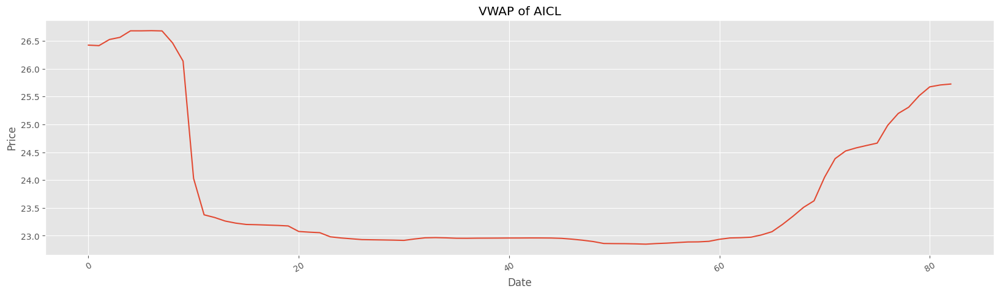

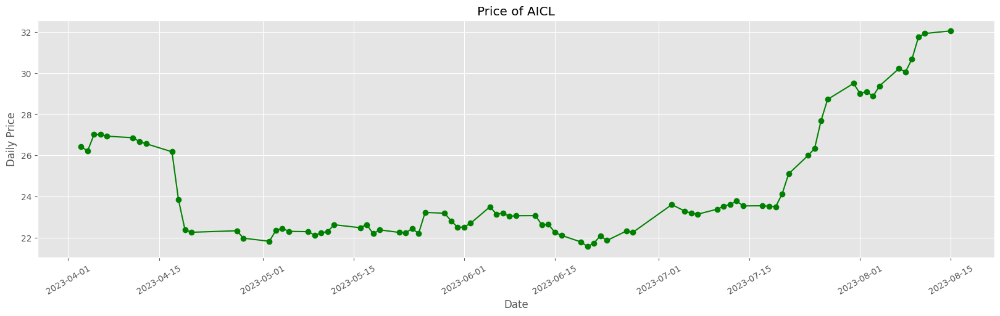

In [231]:

for i, name in enumerate(stocks, 1):
    company = train[train['Scrip'] == name].set_index('Datetime')
    plt.figure(figsize=(20, 5))
    company['Date'] = company.index.date



    company= calculate_vwap(company)
    
    daily_VWAP = company.groupby('Date')['VWAP'].mean().reset_index()  
    

    plt.plot(daily_VWAP.index, daily_VWAP['VWAP'])


    plt.title("VWAP of " +str(company['Scrip'][0]))

    plt.xlabel("Date")
    plt.ylabel("Price")
    plt.xticks(rotation=30)
    
    

    plt.figure(figsize=(20, 5))

    daily_price = company.groupby('Date')['Price'].mean().reset_index()  # For mean
    plt.plot(daily_price['Date'], daily_price['Price'],color="g",marker="o")

    plt.title('Price of '+str(company['Scrip'][0]))
    plt.xlabel("Date")
    plt.ylabel("Daily Price")
    plt.xticks(rotation=30)
    



### <div style="padding:20px;color:white;margin:0;font-size:100%;text-align:left;display:fill;border-radius:5px;background-color:#1a0c00;overflow:hidden">**ROC**


Measure how quickly the price is changing to identify momentum.

**Explanation:**
_ROC measures the percentage change in price over a specific period. It’s a momentum indicator that shows the speed at which the price is changing._

**Better Values:**

- A positive ROC indicates a rising trend, suggesting buying opportunities.
- A negative ROC indicates a falling trend, suggesting selling opportunities.

**Worse Values:**

- Extremely high ROC values might indicate overbought conditions, signaling a potential for a price correction.
- Extremely low ROC values might indicate oversold conditions, signaling a potential for a price rebound.


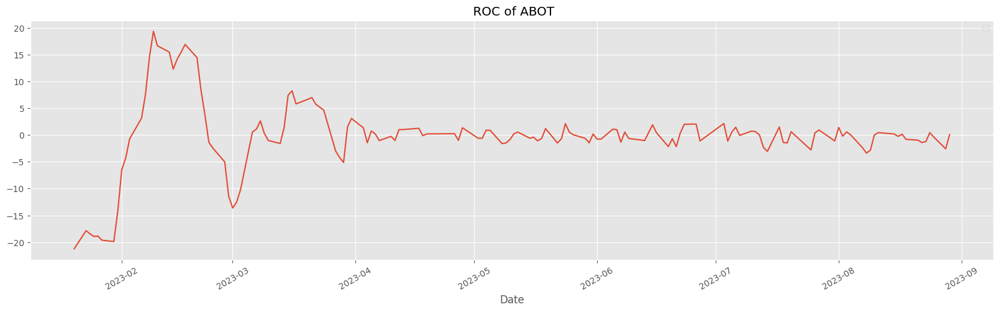

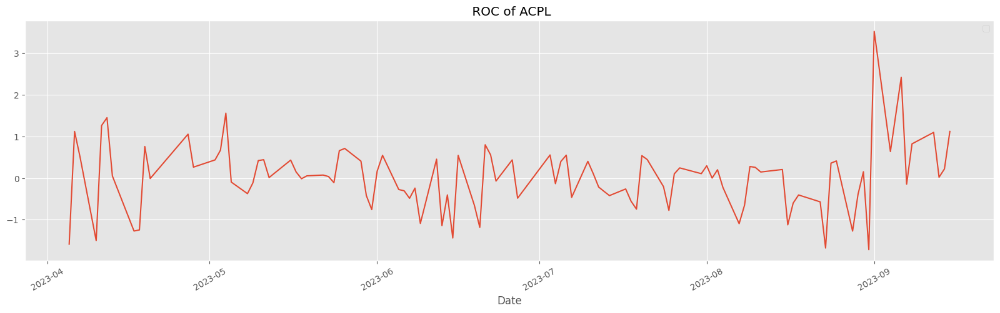

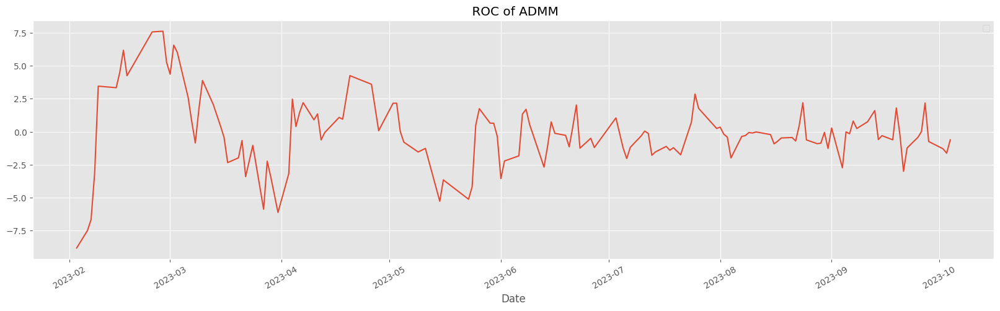

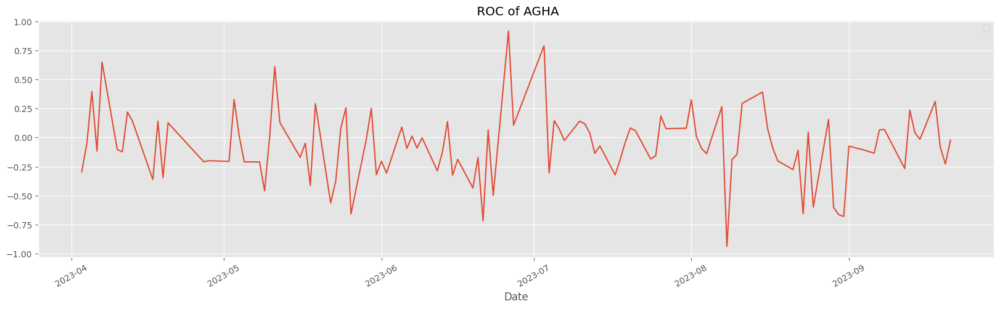

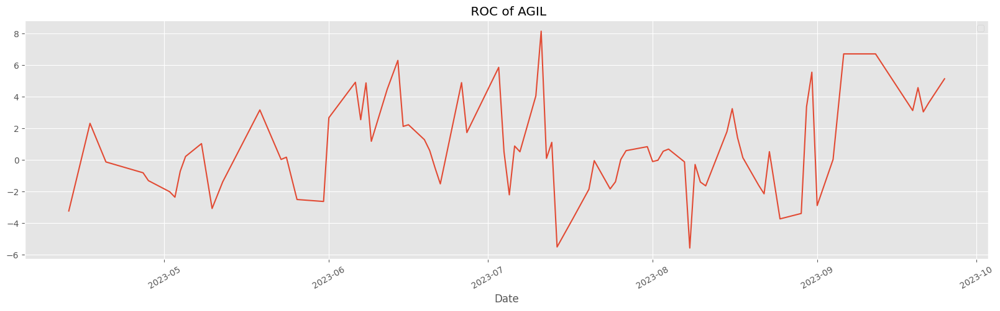

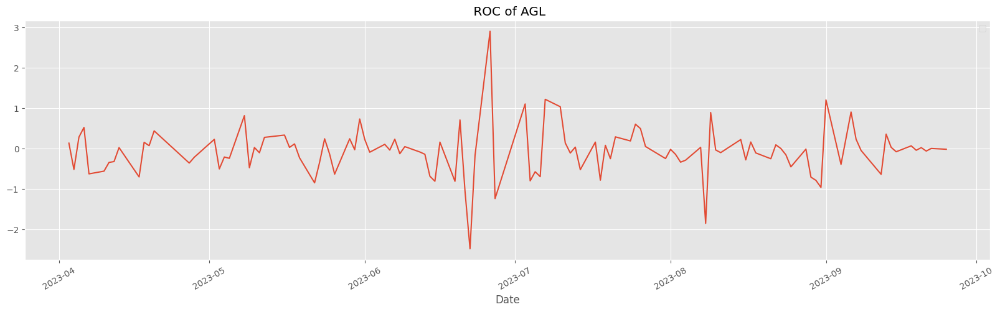

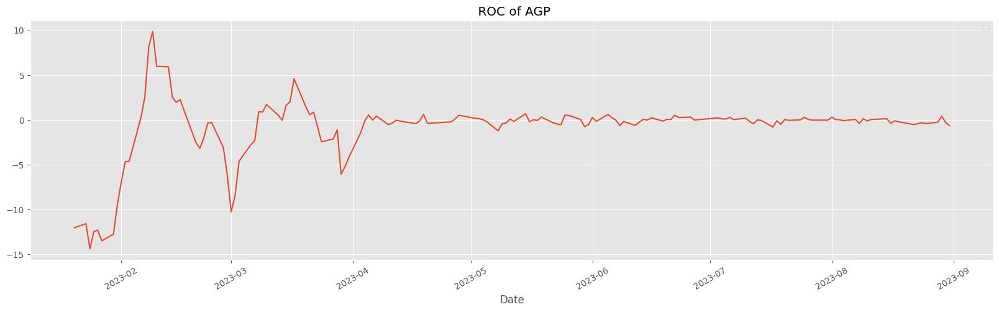

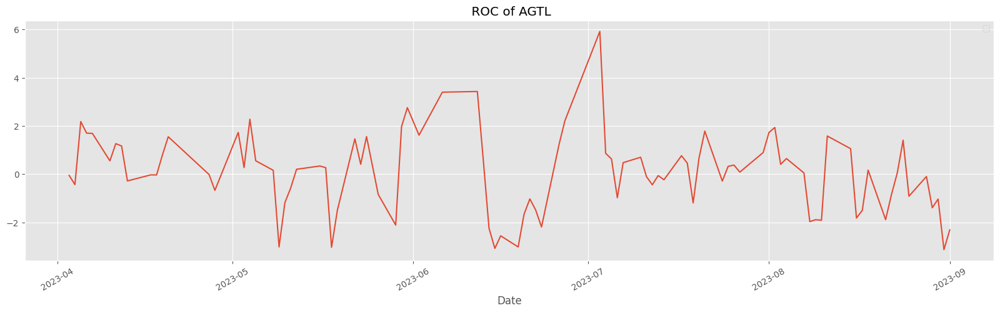

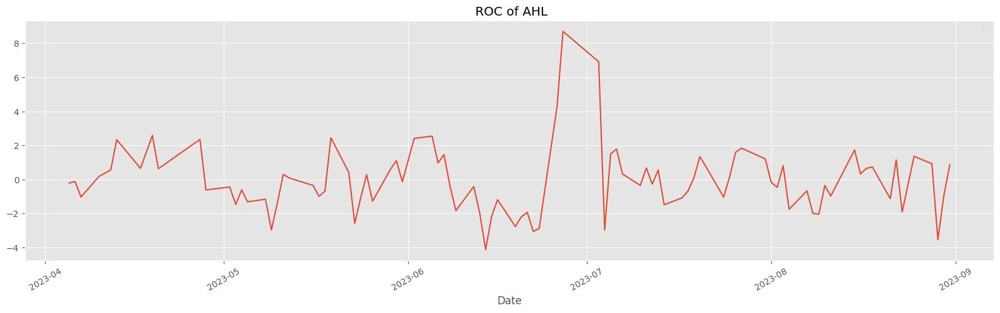

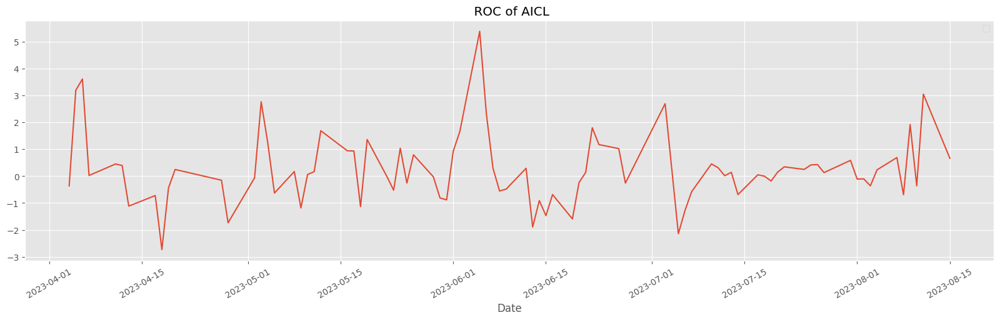

In [232]:

for i, name in enumerate(stocks, 1):
    company = train[train['Scrip'] == name].set_index('Datetime')
    plt.figure(figsize=(20, 5))
    company['Date'] = company.index.date



    company= calculate_roc(company)
    
    daily_ROC = company.groupby('Date')['ROC'].mean().reset_index()  
    

    plt.plot(daily_ROC['Date'], daily_ROC['ROC'])


    plt.title(" ROC of " +str(company['Scrip'][0]))
    plt.legend()

    plt.xlabel("Date")
    plt.xticks(rotation=30)
    



##### <div style="padding:20px;color:white;margin:0;font-size:100%;text-align:left;display:fill;border-radius:5px;background-color:#1a0c00;overflow:hidden"> Identifying Trend and Seasonality


In [233]:
from numpy import polyfit

def fit(X, y, degree=3):
    coef = polyfit(X, y, degree)
    trendpoly = np.poly1d(coef)
    return trendpoly(X)

def get_season(s, yearly_periods=4, degree=3): 
    X = [i%(365/4) for i in range(0, len(s))] 
    seasonal = fit(X, s.values, degree) 
    return pd.Series(data=seasonal, index=s.index)

def get_trend(s, degree=3): 
    X = list(range(len(s))) 
    trend = fit(X, s.values, degree) 
    return pd.Series(data=trend, index=s.index)

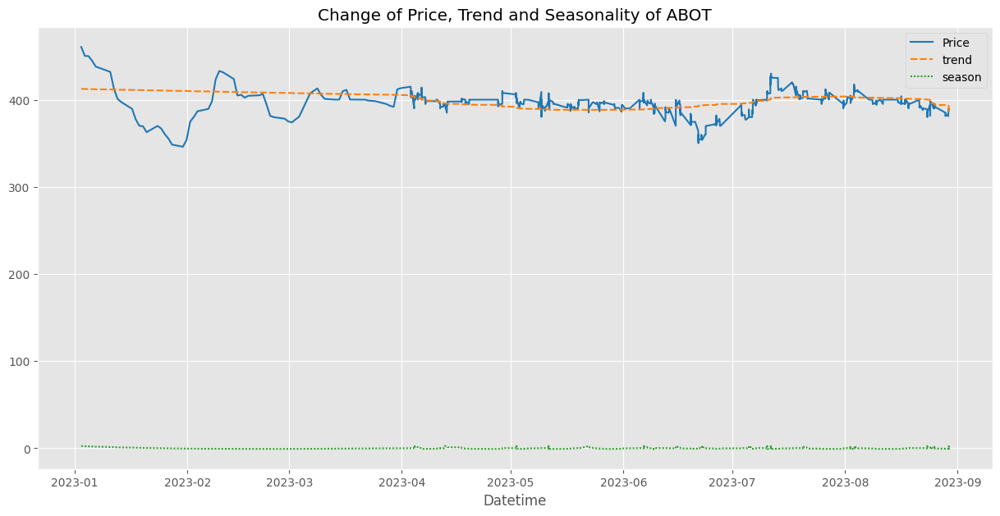

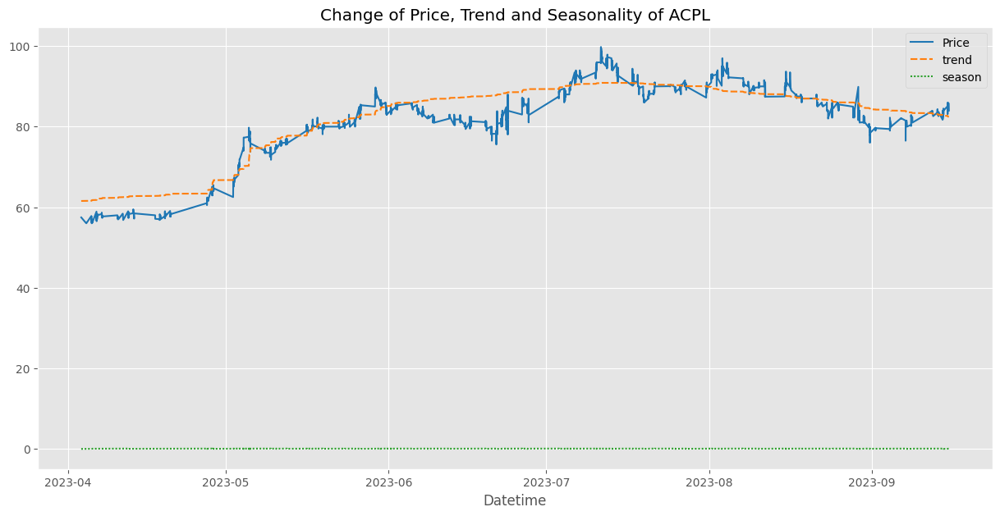

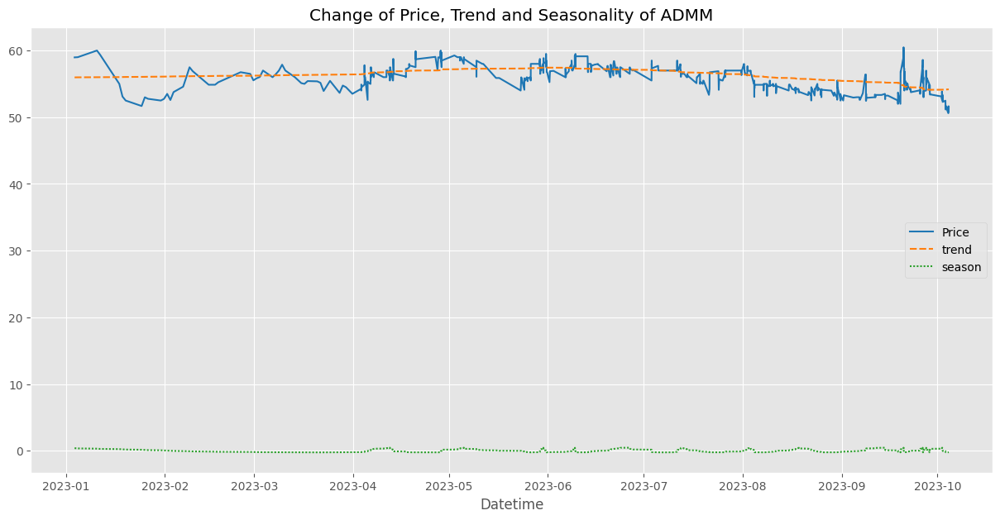

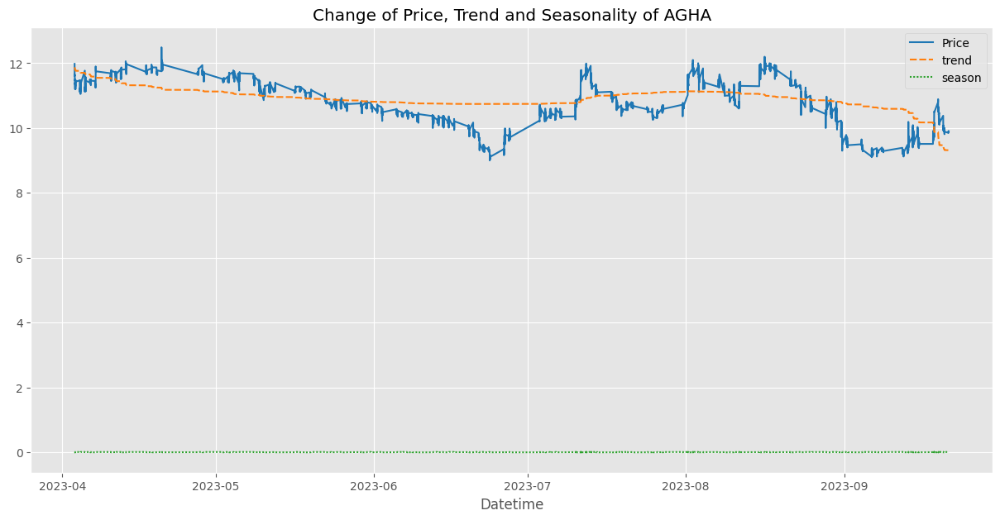

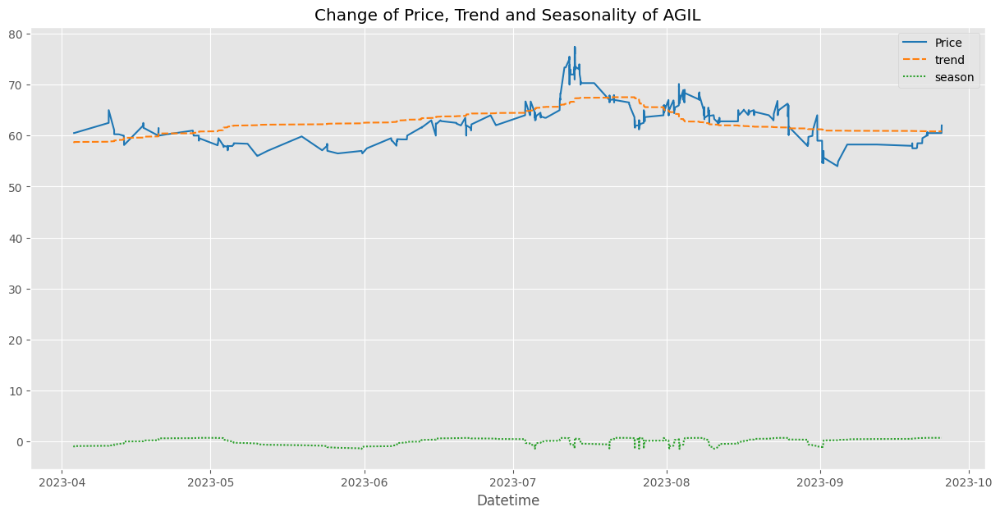

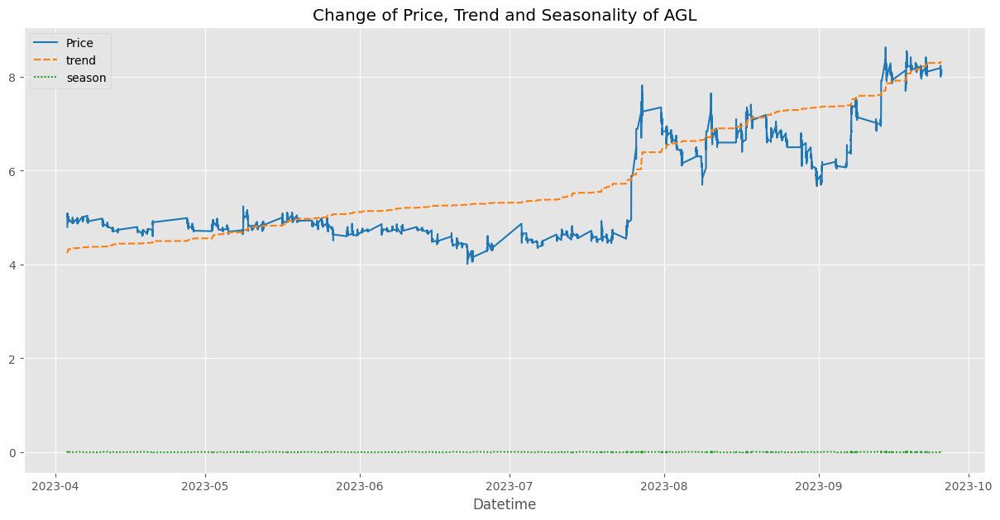

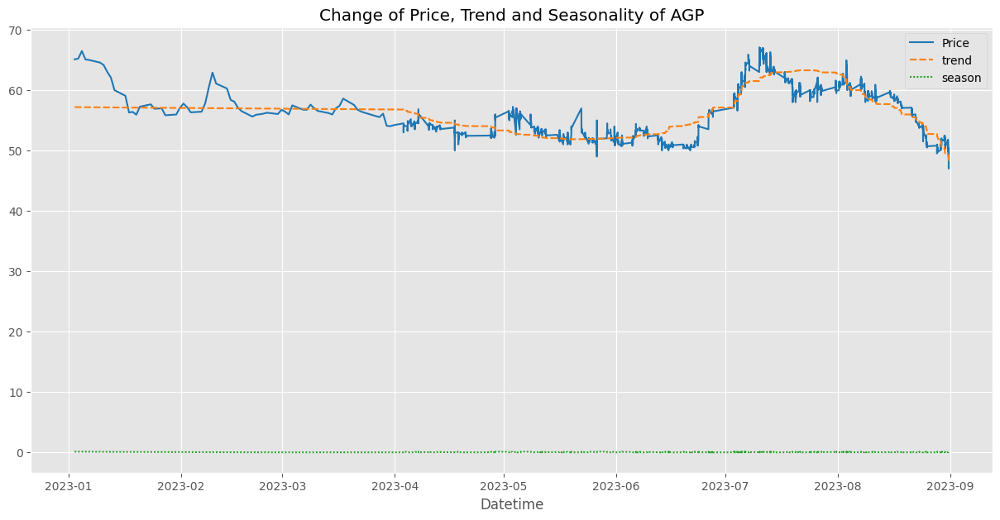

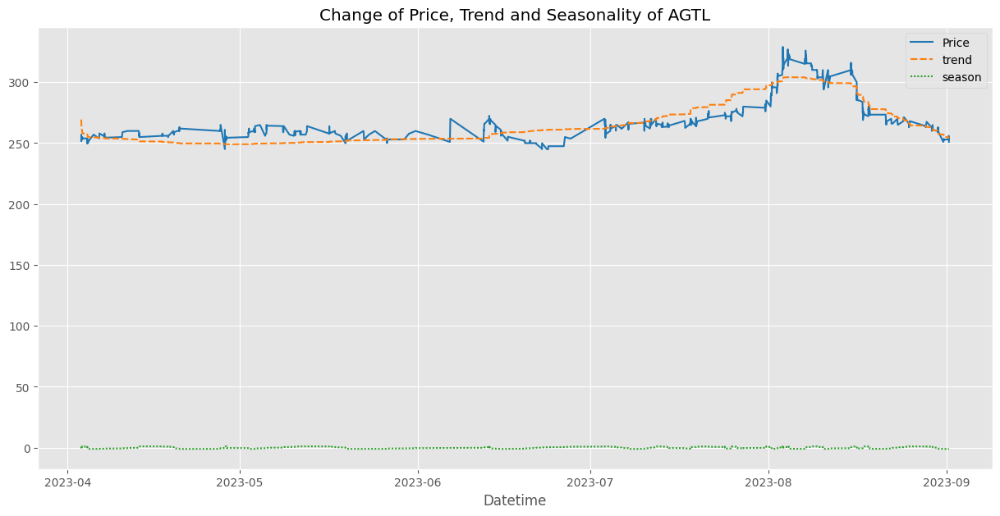

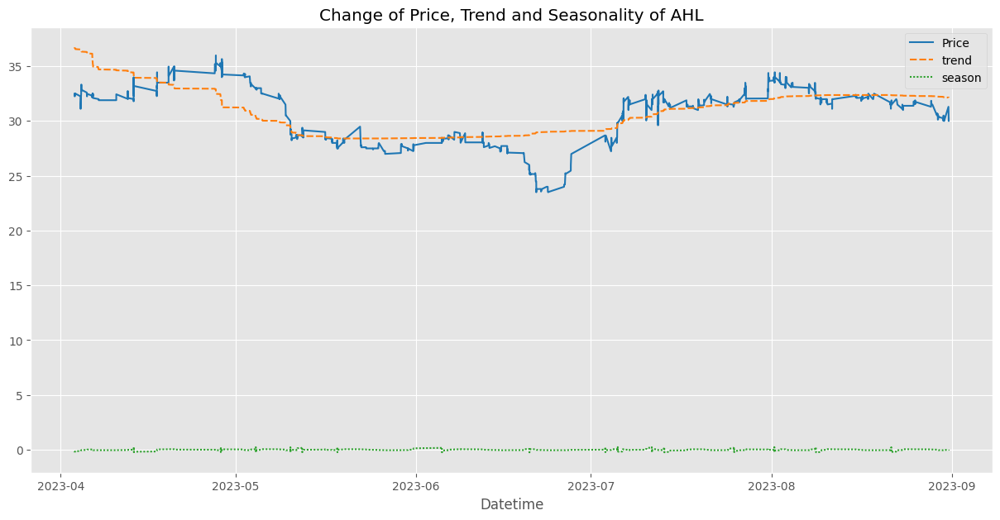

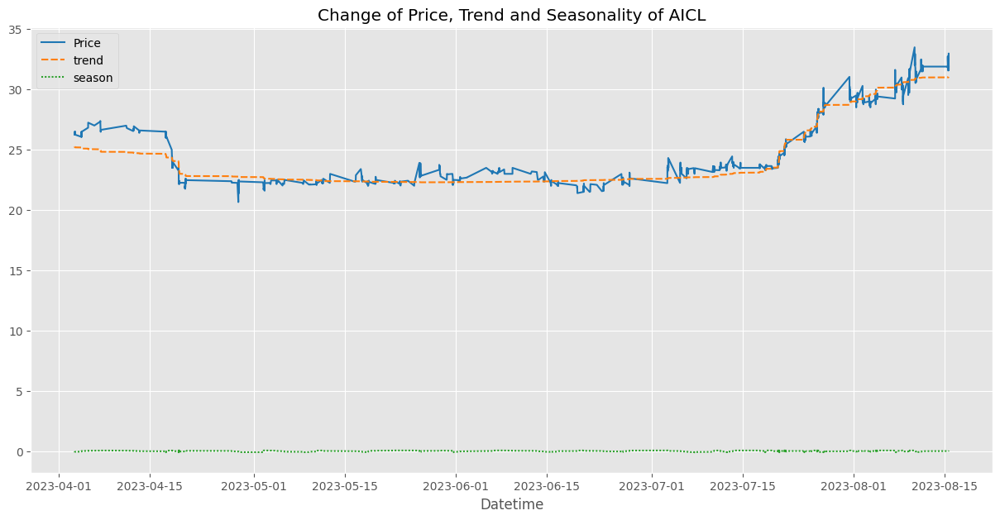

In [234]:
for i in stocks:
    plt.figure(figsize=(15, 7))
    stock = train[train['Scrip'] == i].set_index('Datetime')
    stock['trend'] = get_trend(stock['Price'])
    stock['season'] = get_season(stock['Price']-stock['trend'])
    
    sns.lineplot(data=stock[['Price', 'trend', 'season']], palette='tab10', linewidth=1.5)
    plt.title(f'Change of Price, Trend and Seasonality of {i}')
    plt.show()


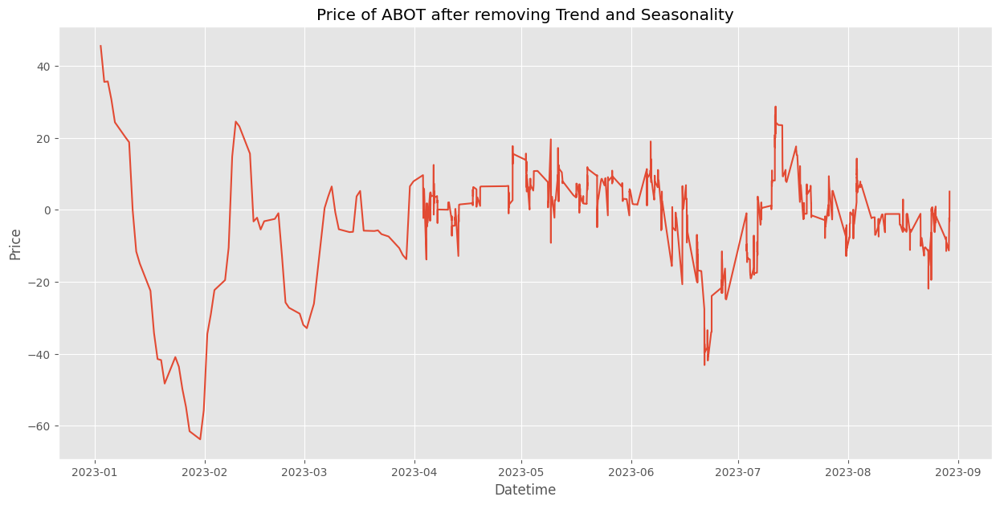

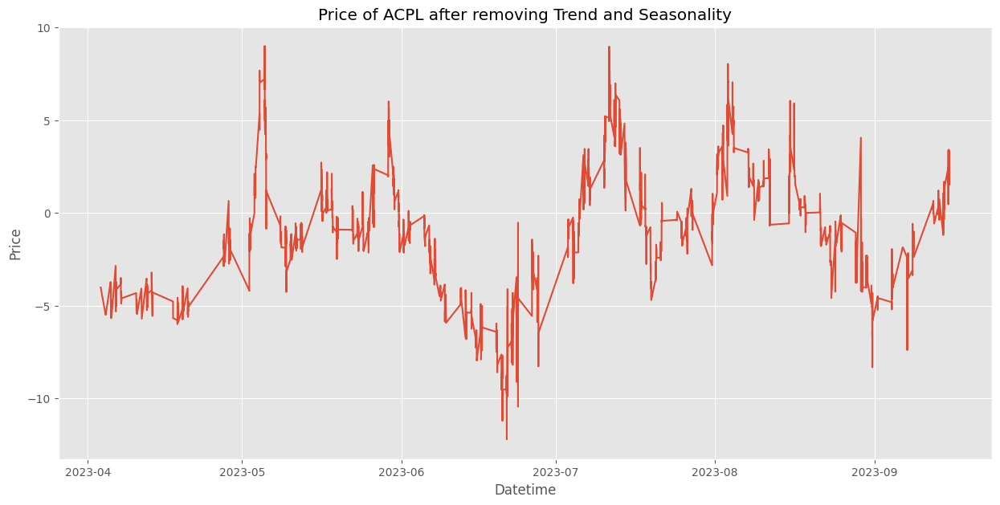

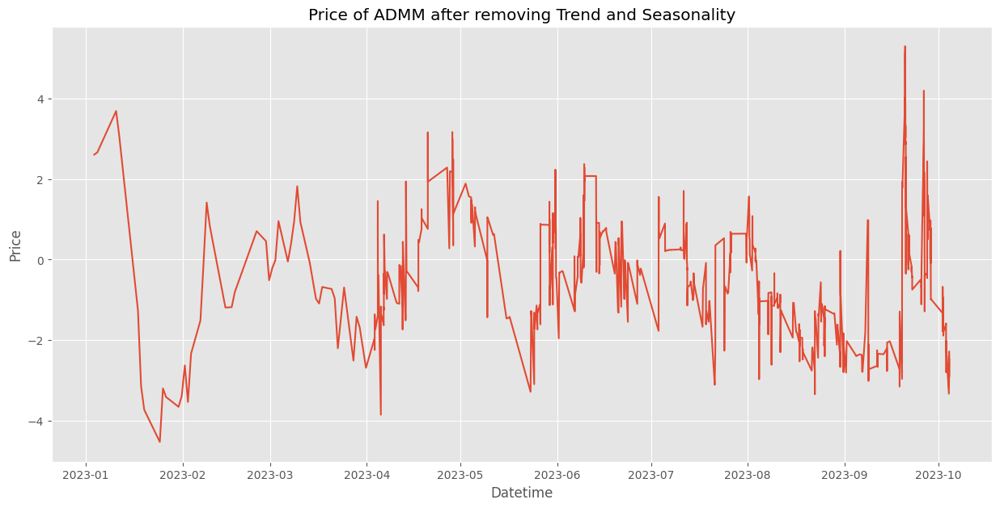

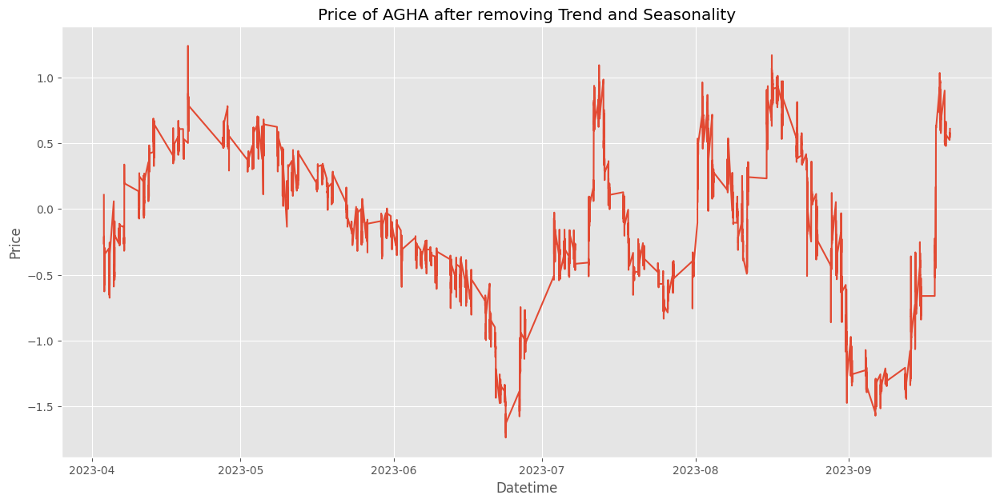

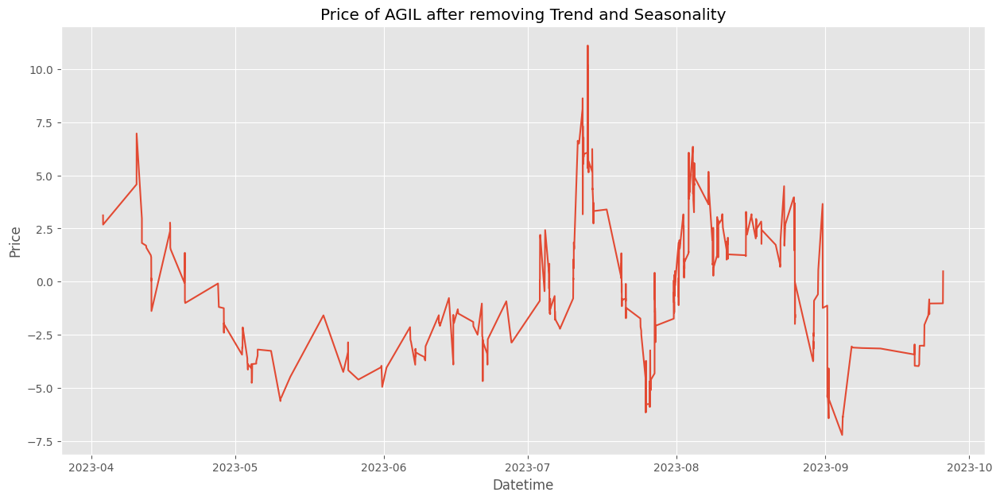

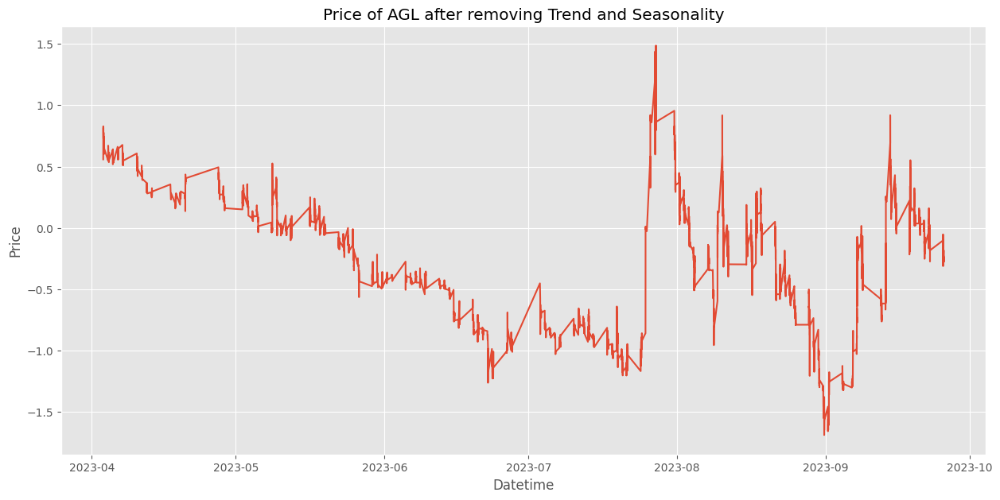

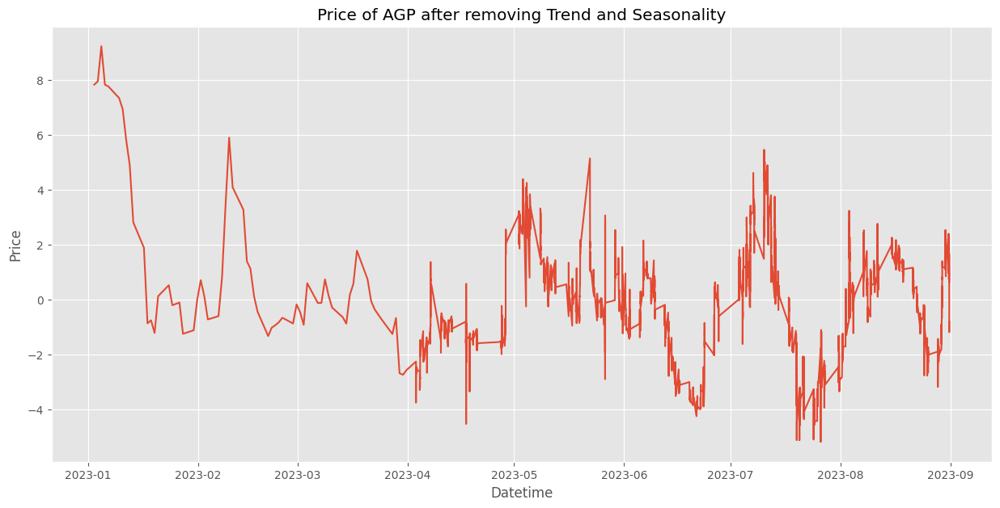

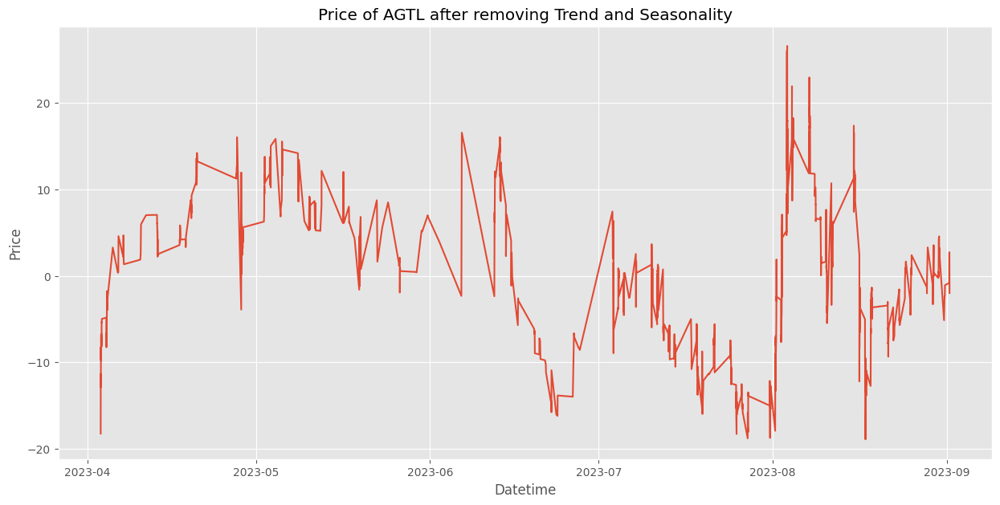

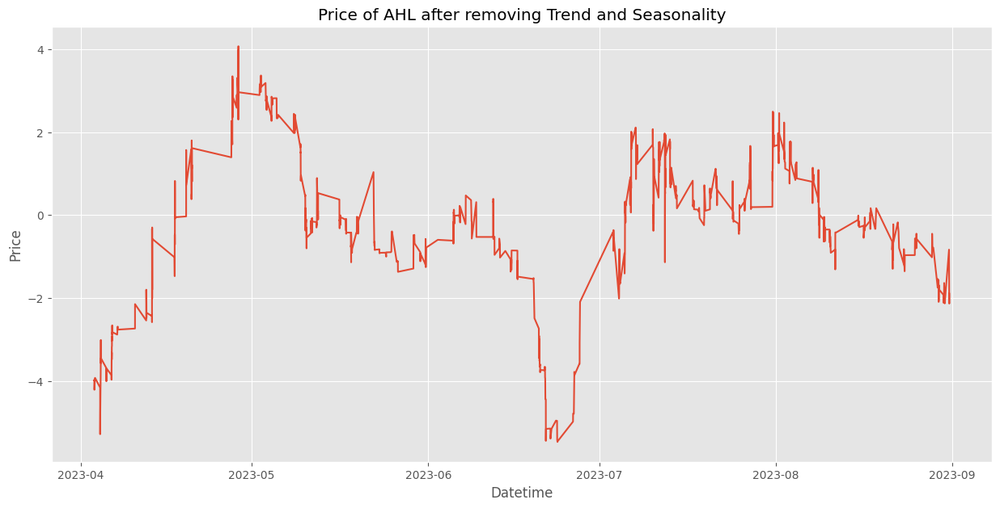

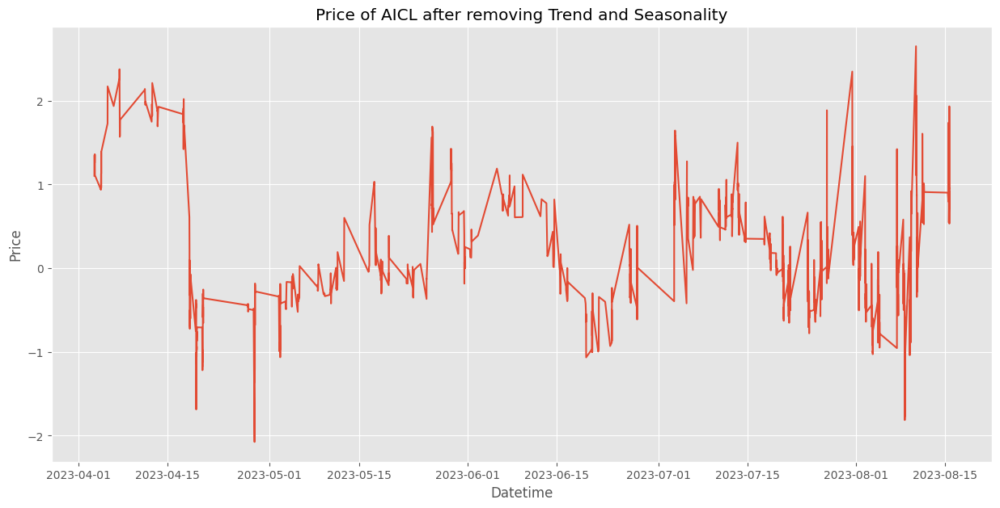

In [235]:
for i in stocks:
    plt.figure(figsize=(15, 7))
    stock = train[train['Scrip'] == i].set_index('Datetime')
    stock['Price'] = stock['Price'] - get_trend(stock['Price'])
    stock['Price'] = stock['Price'] - get_season(stock['Price'])
    
    sns.lineplot(data=stock['Price'], palette='tab10', linewidth=1.5)
    plt.title(f'Price of {i} after removing Trend and Seasonality')
    plt.show()

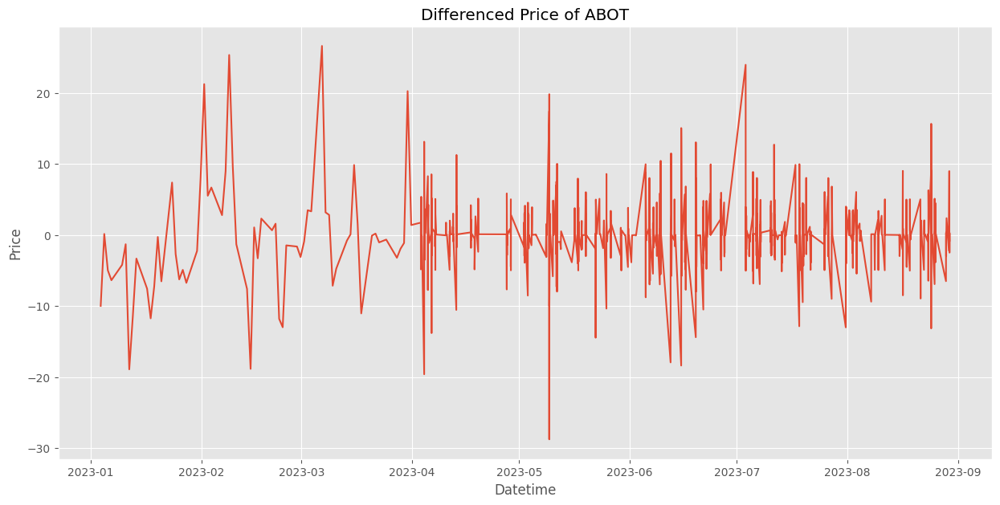

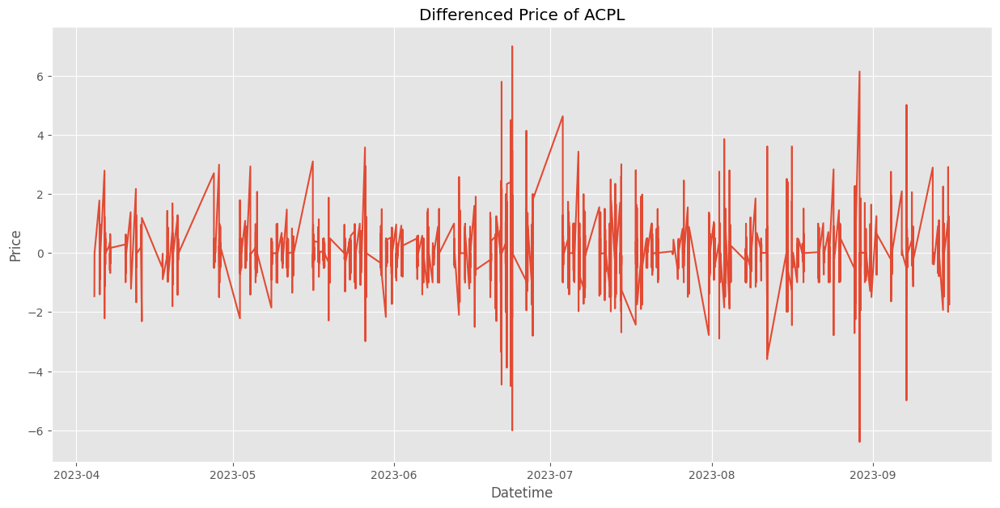

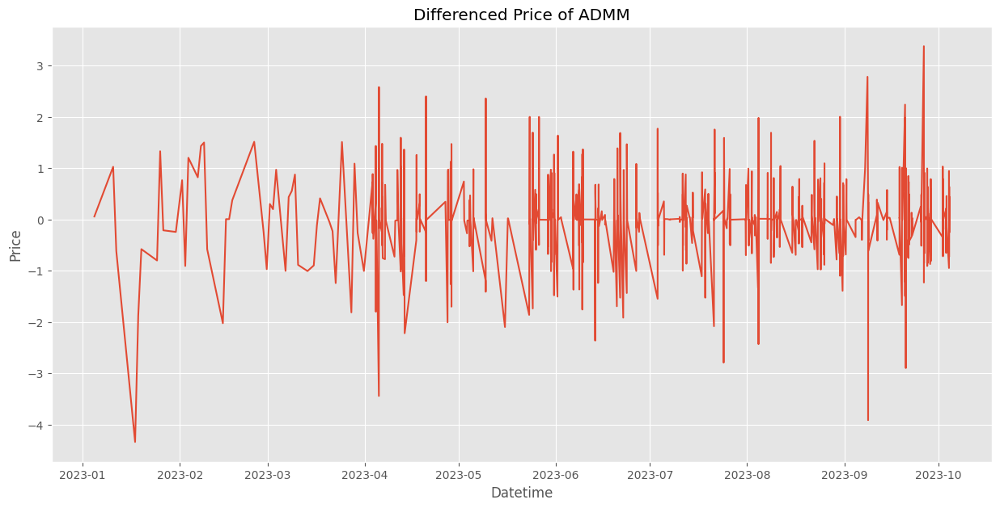

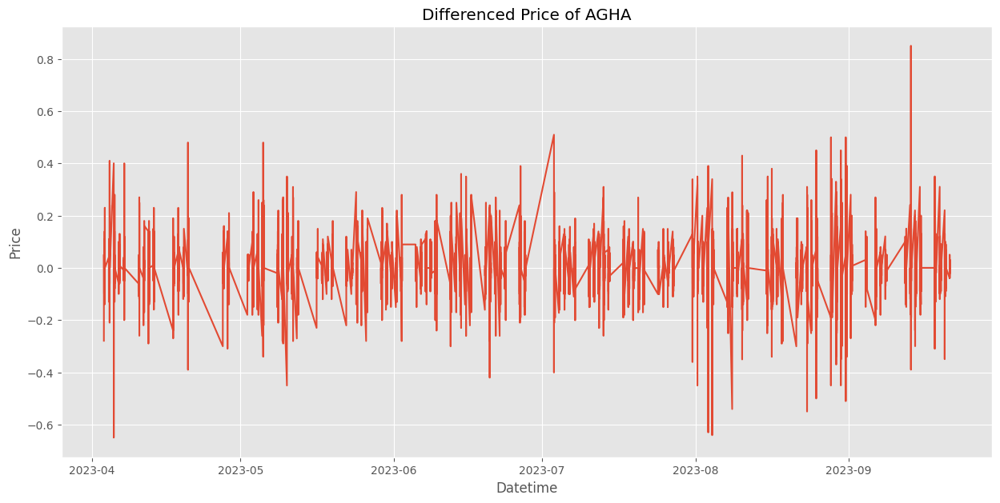

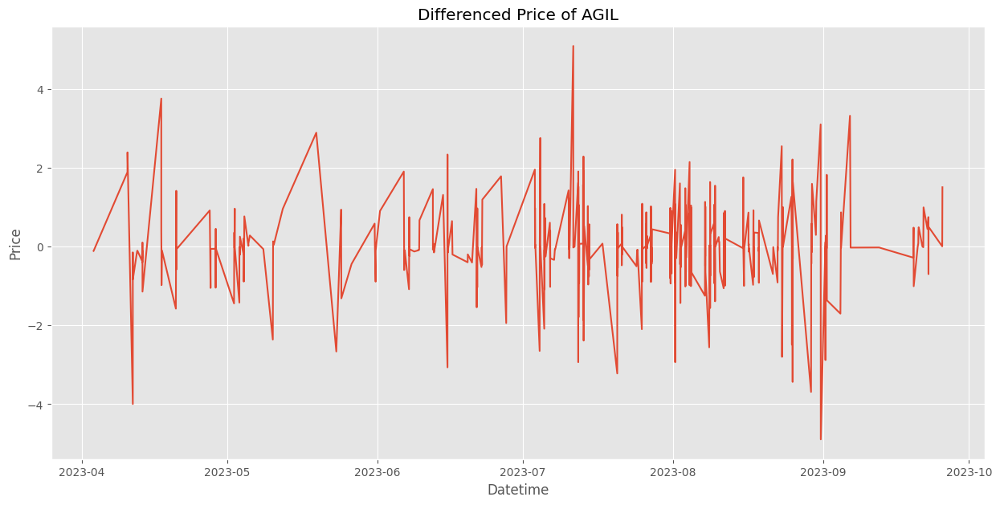

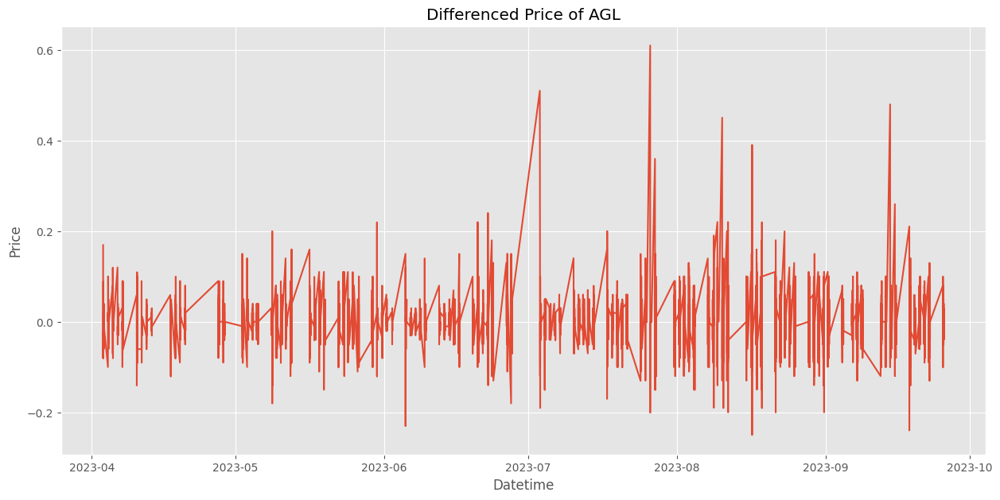

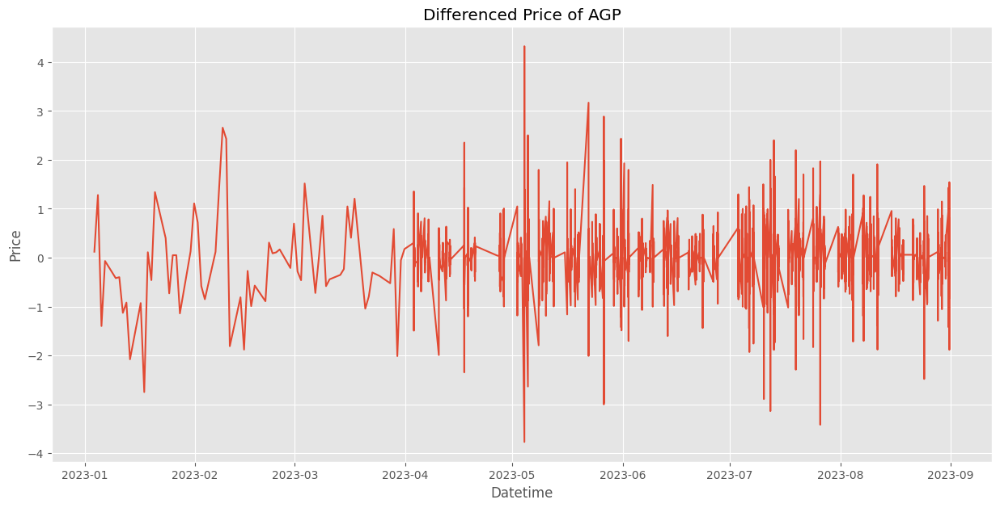

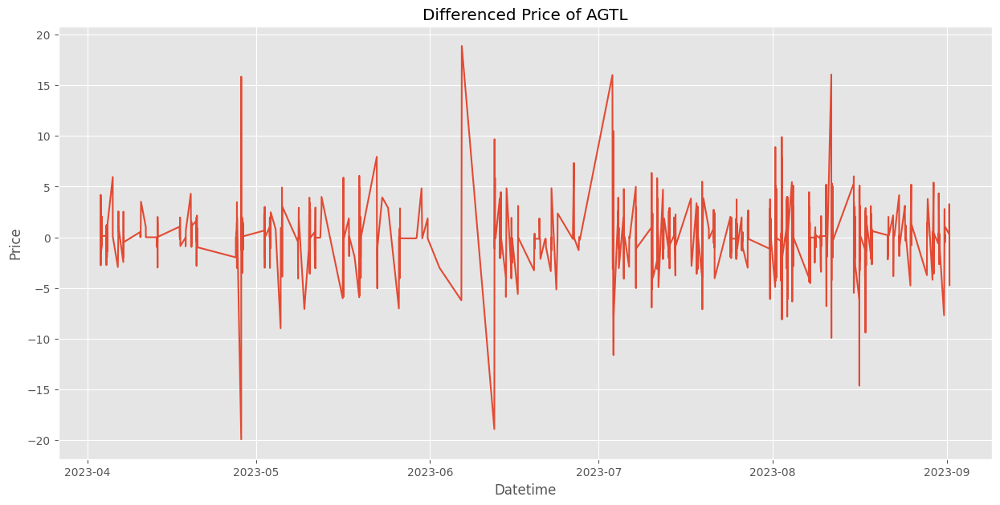

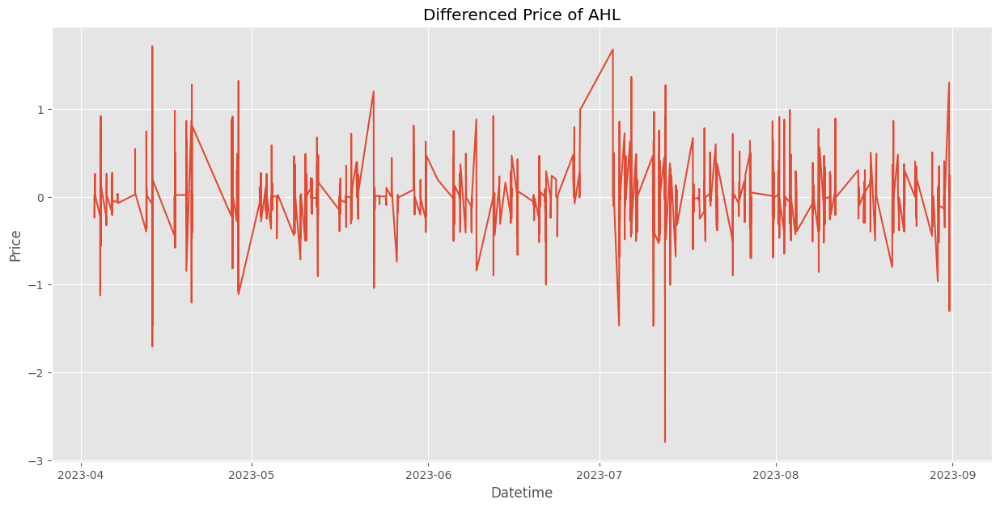

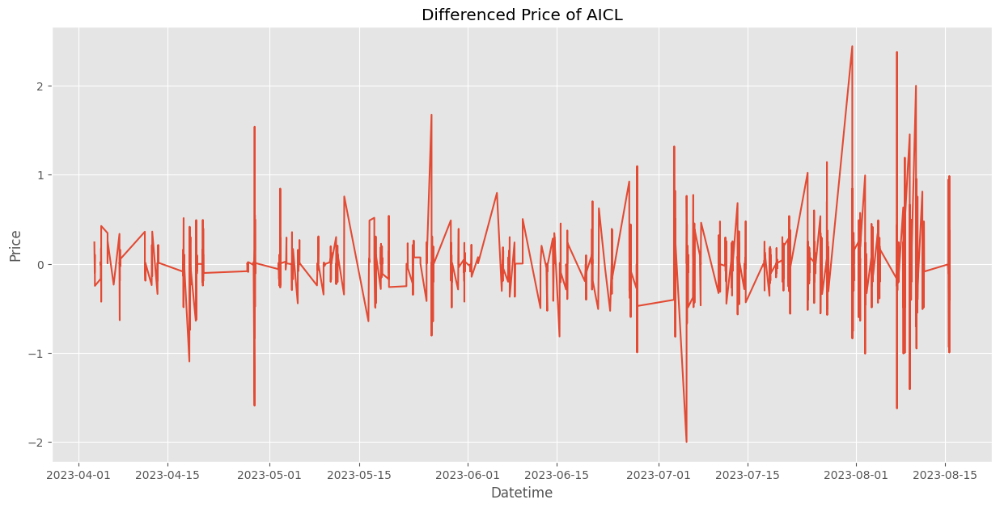

In [236]:
for i in stocks:
    plt.figure(figsize=(15, 7))
    stock = train[train['Scrip'] == i].set_index('Datetime')
    stock['Price'] = stock['Price'] - get_trend(stock['Price'])
    stock['Price'] = stock['Price'] - get_season(stock['Price'])
    
    sns.lineplot(data=stock['Price'].diff(), palette='tab10', linewidth=1.5)
    plt.title(f'Differenced Price of {i}')
    plt.show()

## Comparing Stocks Performance


In [237]:
stocks

['ABOT', 'ACPL', 'ADMM', 'AGHA', 'AGIL', 'AGL', 'AGP', 'AGTL', 'AHL', 'AICL']

In [238]:
ABOT = train[train['Scrip'] == 'ABOT'].set_index('Datetime')
ACPL = train[train['Scrip'] == 'ACPL'].set_index('Datetime')
ADMM = train[train['Scrip'] == 'ADMM'].set_index('Datetime')
AGHA = train[train['Scrip'] == 'AGHA'].set_index('Datetime')
AGIL = train[train['Scrip'] == 'AGIL'].set_index('Datetime')
AGL = train[train['Scrip'] == 'AGL'].set_index('Datetime')
AGP = train[train['Scrip'] == 'AGP'].set_index('Datetime')
AGTL = train[train['Scrip'] == 'AGTL'].set_index('Datetime')
AHL = train[train['Scrip'] == 'AHL'].set_index('Datetime')
AICL = train[train['Scrip'] == 'AICL'].set_index('Datetime')

In [239]:
fig = go.Figure()

for i in stocks:
    stock = train[train['Scrip'] == i].set_index('Datetime')
    first_val = stock['Price'][0]
    normalized = stock['Price'].div(first_val).mul(100)
    
    # Calculate the moving average (e.g., 30 days moving average)
    trend = normalized.rolling(window=30).mean()
    
    # Add trend line to the figure
    fig.add_trace(go.Scatter(
        x=trend.index,
        y=trend,
        mode='lines',
        name=i
    ))

fig.update_layout(
    title='Trend Lines of Normalized Prices of Stocks',
    xaxis_title='Date',
    yaxis_title='Normalized Price',
    legend_title='Stocks',
    template='plotly'
)

fig.show()


- This graph shows us that the ACPL and AGL more than 130% in 8 months
- While AHL, AGHA, AGP, AICL and ABOT have devalued about 5% to 15%.
- Other remained a constant postion with some up and down spikes


### <div style="padding:20px;color:white;margin:0;font-size:100%;text-align:left;display:fill;border-radius:5px;background-color:#1a0c00;overflow:hidden"> Analyzing Seasonality of different Stocks


In [240]:
def analyze_seasonality(stock_name):
    stock = train[train['Scrip'] == stock_name].set_index('Datetime')
    stock['Price'] = pd.to_numeric(stock['Price'], errors='coerce')
    stock = stock.dropna(subset=['Price'])
    stock = stock.reset_index()
    stock = stock.rename(columns={'Datetime': 'ds', 'Price': 'y'})
    
    # Fit Prophet model
    model = Prophet(yearly_seasonality=True, daily_seasonality=True)
    model.fit(stock)
    
    future = model.make_future_dataframe(periods=0)  # No need for future prediction, just decomposition
    forecast = model.predict(future)
    
    # Check available seasonal components
    seasonal_components = [col for col in forecast.columns if 'seasonal' in col]
    
    if not seasonal_components:
        print(f"No seasonal components found for {stock_name}.")
        seasonal = pd.Series(0, index=forecast.index)
    else:
        # Extract seasonal component
        seasonal = forecast[seasonal_components].sum(axis=1)
    
    # Extract trend and residual components
    trend = forecast['trend']
    residual = stock['y'] - trend - seasonal
    
    # Plot the results
    fig = go.Figure()
    
    fig.add_trace(go.Scatter(
        x=stock['ds'],
        y=stock['y'],
        mode='lines',
        name='Observed'
    ))
    
    fig.add_trace(go.Scatter(
        x=stock['ds'],
        y=trend,
        mode='lines',
        name='Trend'
    ))
    
    fig.add_trace(go.Scatter(
        x=stock['ds'],
        y=seasonal,
        mode='lines',
        name='Seasonal'
    ))
    
    fig.add_trace(go.Scatter(
        x=stock['ds'],
        y=residual,
        mode='lines',
        name='Residual'
    ))
    
    fig.update_layout(
        title=f'Prophet Decomposition of {stock_name}',
        xaxis_title='Date',
        yaxis_title='Price',
        legend_title='Components',
        template='plotly'
    )
    
    fig.show()

# Analyze seasonality for each stock
for stock_name in stocks:
    analyze_seasonality(stock_name)

17:43:37 - cmdstanpy - INFO - Chain [1] start processing
17:43:39 - cmdstanpy - INFO - Chain [1] done processing


No seasonal components found for ABOT.


17:43:40 - cmdstanpy - INFO - Chain [1] start processing
17:44:02 - cmdstanpy - INFO - Chain [1] done processing


No seasonal components found for ACPL.


17:44:03 - cmdstanpy - INFO - Chain [1] start processing
17:44:03 - cmdstanpy - INFO - Chain [1] done processing


No seasonal components found for ADMM.


17:44:05 - cmdstanpy - INFO - Chain [1] start processing
17:45:12 - cmdstanpy - INFO - Chain [1] done processing


No seasonal components found for AGHA.


17:45:16 - cmdstanpy - INFO - Chain [1] start processing
17:45:17 - cmdstanpy - INFO - Chain [1] done processing


No seasonal components found for AGIL.


17:45:20 - cmdstanpy - INFO - Chain [1] start processing
17:47:01 - cmdstanpy - INFO - Chain [1] done processing


No seasonal components found for AGL.


17:47:10 - cmdstanpy - INFO - Chain [1] start processing
17:48:05 - cmdstanpy - INFO - Chain [1] done processing


No seasonal components found for AGP.


17:48:13 - cmdstanpy - INFO - Chain [1] start processing
17:48:14 - cmdstanpy - INFO - Chain [1] done processing


No seasonal components found for AGTL.


17:48:17 - cmdstanpy - INFO - Chain [1] start processing
17:48:18 - cmdstanpy - INFO - Chain [1] done processing


No seasonal components found for AHL.


17:48:21 - cmdstanpy - INFO - Chain [1] start processing
17:48:33 - cmdstanpy - INFO - Chain [1] done processing


No seasonal components found for AICL.


Seasonality is not present in any of the stocks


### <div style="padding:20px;color:white;margin:0;font-size:100%;text-align:left;display:fill;border-radius:5px;background-color:#1a0c00;overflow:hidden"> Time Series Modelling
